<a href="https://colab.research.google.com/github/sachalapins/DAS-N2N/blob/main/results.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Python notebook for reproducing results in paper "DAS-N2N: Machine learning Distributed Acoustic Sensing (DAS) signal denoising without clean data" (https://arxiv.org/abs/2304.08120)

## 1. Install / import packages

*__NB__ You must restart runtime after installing obspy*

In [1]:
# Restart runtime after installing obspy
!pip install obspy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
# DASpy requires pylops
!pip install pylops

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.9/275.9 kB 16.7 MB/s eta 0:00:00


In [3]:
# Clone DAS-N2N GitHub repo
!git clone https://github.com/sachalapins/DAS-N2N.git

Cloning into 'DAS-N2N'...
remote: Enumerating objects: 107, done.
remote: Counting objects: 100% (38/38), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 107 (delta 12), reused 0 (delta 0), pack-reused 69
Receiving objects: 100% (107/107), 6.28 MiB | 2.39 MiB/s, done.
Resolving deltas: 100% (35/35), done.


In [4]:
# Add DAS-N2N repo to path (for importing DASpy)
import sys
sys.path.insert(0, "DAS-N2N")

In [5]:
#### 1. IMPORT LIBRARIES ####

from DASpy.config import data_path
from DASpy.IO import tdms_reader 
from DASpy.IO import utils
from DASpy.plot import plot
from DASpy.filters import filters

import tensorflow as tf # version 2
from tensorflow import keras
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras import losses

from skimage.util import view_as_blocks, view_as_windows # For cutting up signal into blocks

import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
from obspy import read
from obspy import Stream, Trace
from obspy import UTCDateTime

import time
import os
import pathlib
import random
import glob
import math

import pickle
from datetime import datetime
import psutil
import gc

tf.config.list_physical_devices('GPU') # Check GPU available

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [6]:
# Tensorflow version
tf.__version__

'2.12.0'

## 2. Load pre-trained denoising models (DAS-N2N and jDAS)

In [7]:
#### LOAD MODELS ####
dasn2n = load_model("DAS-N2N/dasn2n_model") # DAS-N2N
jdas = load_model("DAS-N2N/jdas_model") # jDAS

## 3. Load example data (Example \#1 from paper)

In [8]:
# Read in first example (just channels from fibre 1)
example1 = "DAS-N2N/data/BPT1_UTC_20200117_013019.232.mseed"
st_raw = read(example1)

In [9]:
st_raw

986 Trace(s) in Stream:

BP.D0000..Z | 2020-01-17T01:30:19.232000Z - 2020-01-17T01:30:21.279000Z | 1000.0 Hz, 2048 samples
...
(984 other traces)
...
BP.D0985..Z | 2020-01-17T01:30:19.232000Z - 2020-01-17T01:30:21.279000Z | 1000.0 Hz, 2048 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

## 4. Define functions to run DAS-N2N and jDAS models on obspy stream data

In [10]:
def run_dasn2n_on_stream(st_obj, model, batch_size = 24, swapaxes = False, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, overlap = False, track_processing_time = False):

    print("Start function: " + str(datetime.now()))
    # Get input shape for ML model
    model_input_shape = model.input_shape[-2:]

    # Convert stream to array
    st_array = np.swapaxes(np.array(utils.stream2array(st_obj), dtype="float64"), 0, 1)

    print("After converting stream to array: " + str(datetime.now()))
    # Swap axes if necessary
    if swapaxes:
        st_array = np.swapaxes(st_array, 0, 1)

    # Normalise data (by std)
    st_array -= st_array.mean(axis=None) # remove mean
    if normalise_whole_signal:
        if normalise_with_std:
            norm_factor = np.std(st_array, axis=None) # get std of whole signal
        else:
            norm_factor = np.amax(st_array, axis=None)
        
        st_array = st_array / norm_factor # normalise
        print("After normalising data: " + str(datetime.now()))

        
    # Pad array
    st_array_pad = np.pad(st_array, 
                          ((0, model_input_shape[-2] - (st_array.shape[-2] % model_input_shape[-2])), 
                           (0, model_input_shape[-1] - (st_array.shape[-1] % model_input_shape[-1]))), 
                          mode='reflect') # Using reflect as padding with zeros does weird stuff

    if overlap:            
        # Window data (overlapping)
        st_array_blocks = view_as_windows(st_array_pad, model_input_shape, step=(model_input_shape[-2] // 2, model_input_shape[-1] // 2))
    else:
        # Window data (not overlapping)
        st_array_blocks = view_as_blocks(st_array_pad, model_input_shape)

    # Reshape to 3D array to feed into model (, samples, channels)
    model_in = np.reshape(st_array_blocks, (st_array_blocks.shape[0] * st_array_blocks.shape[1], st_array_blocks.shape[2], st_array_blocks.shape[3]))

    print("After padding and reshaping data: " + str(datetime.now()))
    
    if not normalise_whole_signal:
        model_in = model_in - np.mean(model_in, axis=(1,2), keepdims=True)
        if normalise_with_std:
            norm_factor = np.std(model_in, axis=(1,2), keepdims=True)
        else:
            norm_factor = np.amax(model_in, axis=(1,2), keepdims=True)
        model_in = model_in / norm_factor # normalise
        print("After normalising data: " + str(datetime.now()))
        
    # Run model
    if track_processing_time:
        before = datetime.now()
    preds = model.predict(model_in, batch_size = batch_size, verbose=0)
    if track_processing_time:
        processing_time = datetime.now() - before

    print("After running model: " + str(datetime.now()))
    
    # Reshape back
    st_array_out = preds
    
    # Un-normalise data
    st_array_out = st_array_out * norm_factor
    
    # Reshape and do inverse of view_as_blocks
    st_array_out = np.reshape(st_array_out, (st_array_blocks.shape[0], st_array_blocks.shape[1], st_array_blocks.shape[2], st_array_blocks.shape[3]))
    
    if overlap:
        # Keep only middle samples/channels to form non-overlapping smaller blocks (not windows) and invert back to original signal as before
        st_array_out = st_array_out[:,:,(model_input_shape[-2] // 4):(3 * (model_input_shape[-2] // 4)),(model_input_shape[-1] // 4):(3 * (model_input_shape[-1] // 4))]
        st_array_new_shape = (st_array_pad.shape[0] - (2 * (model_input_shape[-2] // 4)), st_array_pad.shape[1] - (2 * (model_input_shape[-1] // 4))) # A few channels/samples missing on either end as looking only at middle of windows
        st_array_out = st_array_out.transpose(0,2,1,3).reshape(st_array_new_shape) # Got from https://forum.omz-software.com/topic/6266/help-inverting-scikimage-utils-view_as_blocks
        # Pad channels then cut back to unpadded size:
        st_array_out = np.pad(st_array_out, 
                              (((model_input_shape[-2] // 4), (model_input_shape[-2] // 4)), 
                               ((model_input_shape[-1] // 4), (model_input_shape[-1] // 4))), 
                              mode='constant') # Pad channels with zeros
    else:
        st_array_out = st_array_out.transpose(0,2,1,3).reshape(st_array_pad.shape) # Got from https://forum.omz-software.com/topic/6266/help-inverting-scikimage-utils-view_as_blocks

    # Cut back to unpadded size:
    st_array_out = st_array_out[:st_array.shape[0],:st_array.shape[1]]
    print("After re-scaling predictions and reshaping back to original signal dims: " + str(datetime.now()))

    # Output
    if return_as_stream:
        st_out = utils.array2stream(st_array_out, 
                                    network=st_obj[0].stats.network, 
                                    fs=st_obj[0].stats.sampling_rate, 
                                    start=st_obj[0].stats.starttime, 
                                    channel_spacing=(st_obj[-1].stats.distance - st_obj[0].stats.distance) / len(st_obj),
                                    units='Strain rate')
        print("After making obspy stream: " + str(datetime.now()))
        if track_processing_time:
            return processing_time.total_seconds(), st_out
        else:
            return st_out
    else:
        if track_processing_time:
            return processing_time.total_seconds(), st_array_out
        else:
            return st_array_out


In [11]:
def run_jdas_on_stream(st_obj, model, batch_size = 12, swapaxes = False, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, track_processing_time = False):

    print("Start function: " + str(datetime.now()))
    # Get input shape for ML model
    model_input_shape = model.input_shape[-2:]

    # Convert stream to array
    if swapaxes:
        st_array = np.array(utils.stream2array(st_obj), dtype="float64")
    else:
        st_array = np.swapaxes(np.array(utils.stream2array(st_obj), dtype="float64"), 0, 1)

    print("After converting stream to array: " + str(datetime.now()))

    # Normalise data (by std)
    st_array -= st_array.mean(axis=None) # remove mean
    if normalise_whole_signal:
        if normalise_with_std:
            norm_factor = np.std(st_array, axis=None) # get std of whole signal
        else:
            norm_factor = np.amax(st_array, axis=None)

        st_array = st_array / norm_factor # normalise
        print("After normalising data: " + str(datetime.now()))

    # Pad array in time direction only - this should work
    st_array_pad = np.pad(st_array, 
                          ((0, model_input_shape[0] - (st_array.shape[-2] % model_input_shape[0])), 
                           (0, 0)), 
                          mode='reflect') # Using reflect as padding with zeros does weird stuff

    st_array_shape = st_array.shape # Only need shape from now on
    del(st_array) # Clear memory
    gc.collect() # Run garbage collection

    # Window data (not overlapping) - need a sliding window and middle channel to be blanked out
    st_array_blocks = view_as_windows(st_array_pad, model_input_shape, step=(model_input_shape[0], 1))

    # No longer need padded array either?
    st_array_pad_shape = st_array_pad.shape
    del(st_array_pad) # Clear memory
    gc.collect() # Run garbage collection

    # Reshape to 3D array to feed into model (, samples, channels)
    model_in = np.reshape(st_array_blocks, (st_array_blocks.shape[0] * st_array_blocks.shape[1], st_array_blocks.shape[2], st_array_blocks.shape[3]))
    model_in_mask = np.ones(model_in.shape)
    model_in_mask[:, (model_input_shape[0] // 2), :] -= 1. # Make middle channel 0's

    print("After padding and reshaping data: " + str(datetime.now()))

    if not normalise_whole_signal:
        model_in = model_in - np.mean(model_in, axis=(1,2), keepdims=True)
        if normalise_with_std:
            norm_factor = np.std(model_in, axis=(1,2), keepdims=True)
        else:
            norm_factor = np.amax(model_in, axis=(1,2), keepdims=True)
        model_in = model_in / norm_factor # normalise
        print("After normalising data: " + str(datetime.now()))

    # Run model
    if track_processing_time:
        before = datetime.now()
    preds = model.predict(model_in * model_in_mask, batch_size = batch_size, verbose=0)
    if track_processing_time:
        processing_time = datetime.now() - before

    print("After running model: " + str(datetime.now()))

    del(model_in_mask) # Clear some memory
    gc.collect() # Run garbage collection
        
    # Un-normalise data
    preds = preds * norm_factor

    # Reshape and do inverse of view_as_blocks
    preds = np.reshape(preds, (st_array_blocks.shape[0], st_array_blocks.shape[1], st_array_blocks.shape[2], st_array_blocks.shape[3]))
    # Keep only middle channel to form blocks (not windows) and invert back to original signal as before
    st_array_out = preds[:,:,:,(model_input_shape[1] // 2):((model_input_shape[1] // 2)+1)]

    del(preds) # Clear some memory
    gc.collect() # Run garbage collection    

    st_array_pad_shape = (st_array_pad_shape[0], st_array_pad_shape[1] - (2 * (model_input_shape[1] // 2))) # A few channels missing on either end as looking only at middle channel
    st_array_out = st_array_out.transpose(0,2,1,3).reshape(st_array_pad_shape) # Got from https://forum.omz-software.com/topic/6266/help-inverting-scikimage-utils-view_as_blocks

    # Pad channels then cut back to unpadded size:
    st_array_out = np.pad(st_array_out, 
                          ((0, 0), 
                           ((model_input_shape[1] // 2), (model_input_shape[1] // 2))), 
                          mode='constant') # Pad channels with zeros
    st_array_out = st_array_out[:st_array_shape[0],:st_array_shape[1]]
    print("After re-scaling predictions and reshaping back to original signal dims: " + str(datetime.now()))

    # Remove mean
    st_array_out -= np.mean(st_array_out)

    if swapaxes:
        st_array_out = np.swapaxes(st_array_out, 0, 1)

    # Output
    if return_as_stream:
        st_out = utils.array2stream(st_array_out, 
                                    network=st_obj[0].stats.network, 
                                    fs=st_obj[0].stats.sampling_rate, 
                                    start=st_obj[0].stats.starttime, 
                                    channel_spacing=(st_obj[-1].stats.distance - st_obj[0].stats.distance) / len(st_obj),
                                    units='Strain rate')
        print("After making obspy stream: " + str(datetime.now()))
        if track_processing_time:
            return processing_time.total_seconds(), st_out
        else:
            return st_out
    else:
        if track_processing_time:
            return processing_time.total_seconds(), st_array_out
        else:
            return st_array_out

## 5. Run models and plot data

In [12]:
# Convert obspy stream to numpy array for plotting
st_raw_array = np.swapaxes(utils.stream2array(st_raw), 0, 1)
st_raw_array -= np.mean(st_raw_array)

In [13]:
# Apply bandpass filter (10 - 100 Hz) as benchmark
st_bp = st_raw.copy()

print("Before bandpass: " + str(datetime.now()))
before = datetime.now()
st_bp.detrend("demean")
st_bp.filter("bandpass", freqmin=10, freqmax=100, zerophase=True)
print("After bandpass: " + str(datetime.now()))
st_bp_array = np.swapaxes(utils.stream2array(st_bp), 0, 1)
st_bp_array -= np.mean(st_bp_array)

Before bandpass: 2023-04-19 15:18:53.057956
After bandpass: 2023-04-19 15:18:55.749715


[]

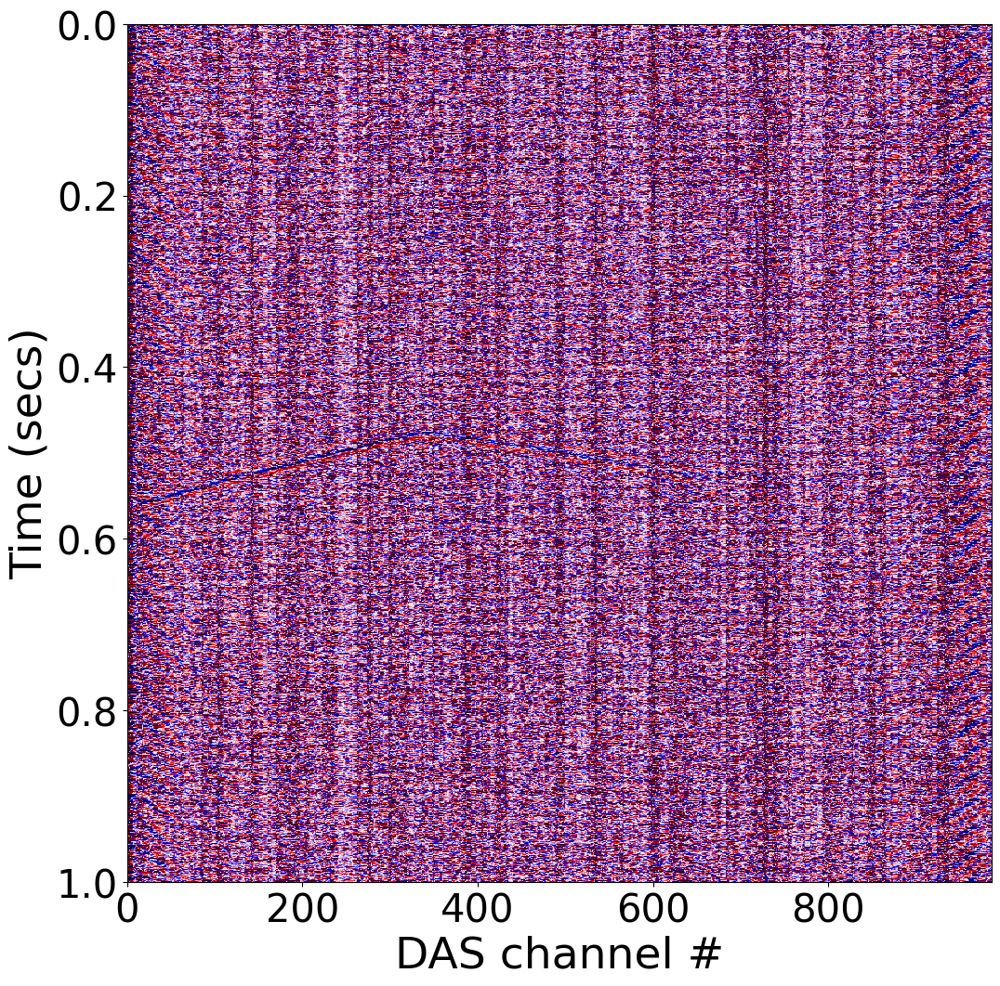

In [14]:
# Plot raw data
plt.rcParams["figure.figsize"] = (12,12) # Fig size

plt.imshow(st_raw_array[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

[]

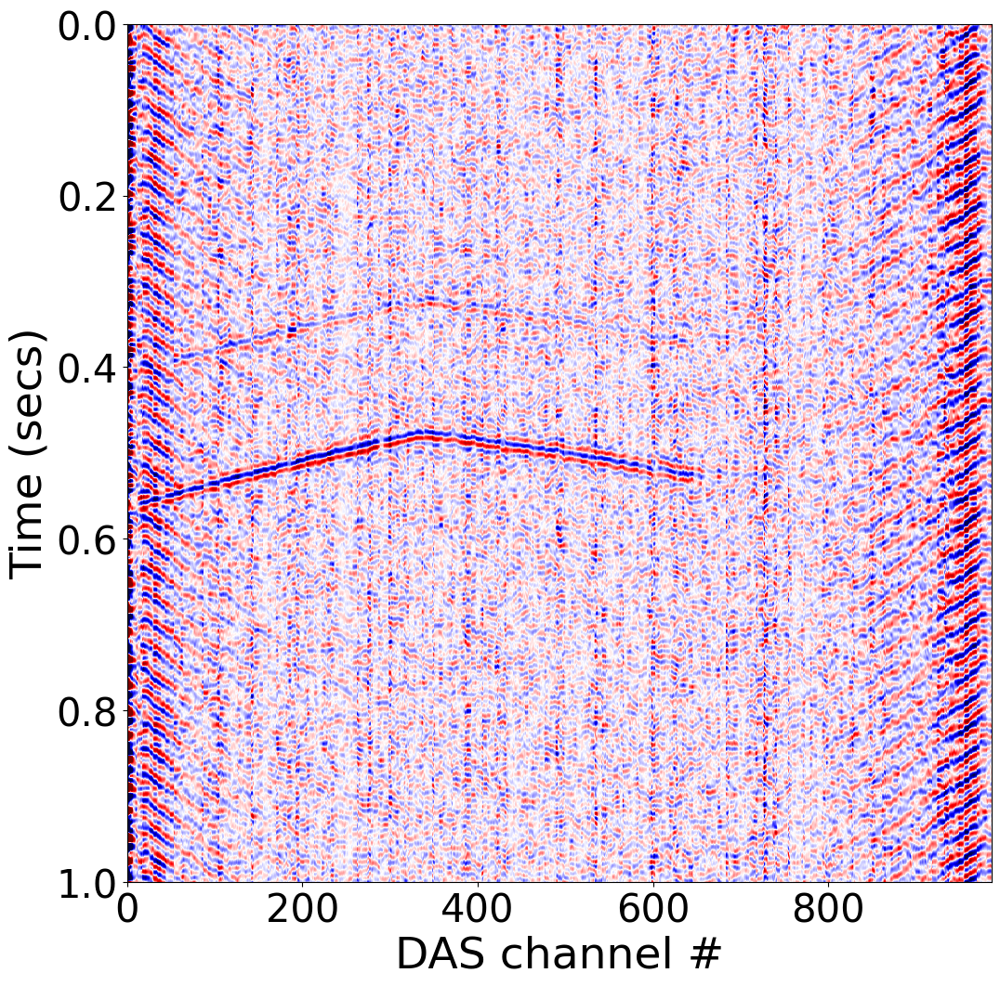

In [15]:
# Plot bandpass filtered data
plt.imshow(st_bp_array[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

In [16]:
# Run DAS-N2N on raw data
st_dasn2n = run_dasn2n_on_stream(st_raw.copy(), dasn2n, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, overlap = False)

Start function: 2023-04-19 15:18:58.327405
After converting stream to array: 2023-04-19 15:18:58.347139
After normalising data: 2023-04-19 15:18:58.359205
After padding and reshaping data: 2023-04-19 15:18:58.372636
After running model: 2023-04-19 15:19:06.918298
After re-scaling predictions and reshaping back to original signal dims: 2023-04-19 15:19:06.923249


In [17]:
# Time taken to run model is quite long above as tensorflow initialising etc the first time
# Run again to see how quick it actually is:
st_dasn2n = run_dasn2n_on_stream(st_raw.copy(), dasn2n, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, overlap = False)

Start function: 2023-04-19 15:19:07.308241
After converting stream to array: 2023-04-19 15:19:07.315285
After normalising data: 2023-04-19 15:19:07.326576
After padding and reshaping data: 2023-04-19 15:19:07.335081
After running model: 2023-04-19 15:19:07.501981
After re-scaling predictions and reshaping back to original signal dims: 2023-04-19 15:19:07.506174


[]

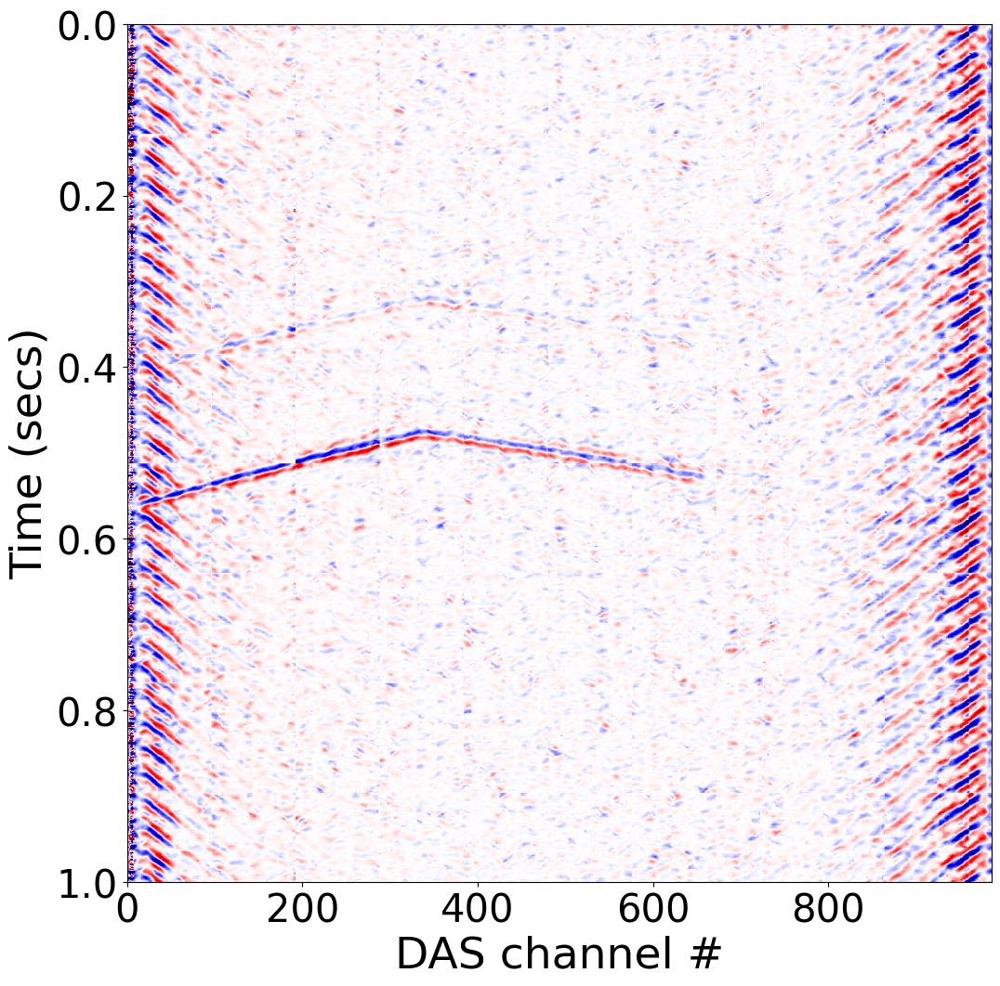

In [18]:
# Plot DAS-N2N processed data
plt.imshow(st_dasn2n[:1000,], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

In [19]:
# Run jDAS on raw data
st_jdas = run_jdas_on_stream(st_raw.copy(), jdas, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, swapaxes=False)

Start function: 2023-04-19 15:19:08.618870
After converting stream to array: 2023-04-19 15:19:08.626563
After normalising data: 2023-04-19 15:19:08.640097
After padding and reshaping data: 2023-04-19 15:19:09.528516
After running model: 2023-04-19 15:19:13.315873
After re-scaling predictions and reshaping back to original signal dims: 2023-04-19 15:19:13.938543


[]

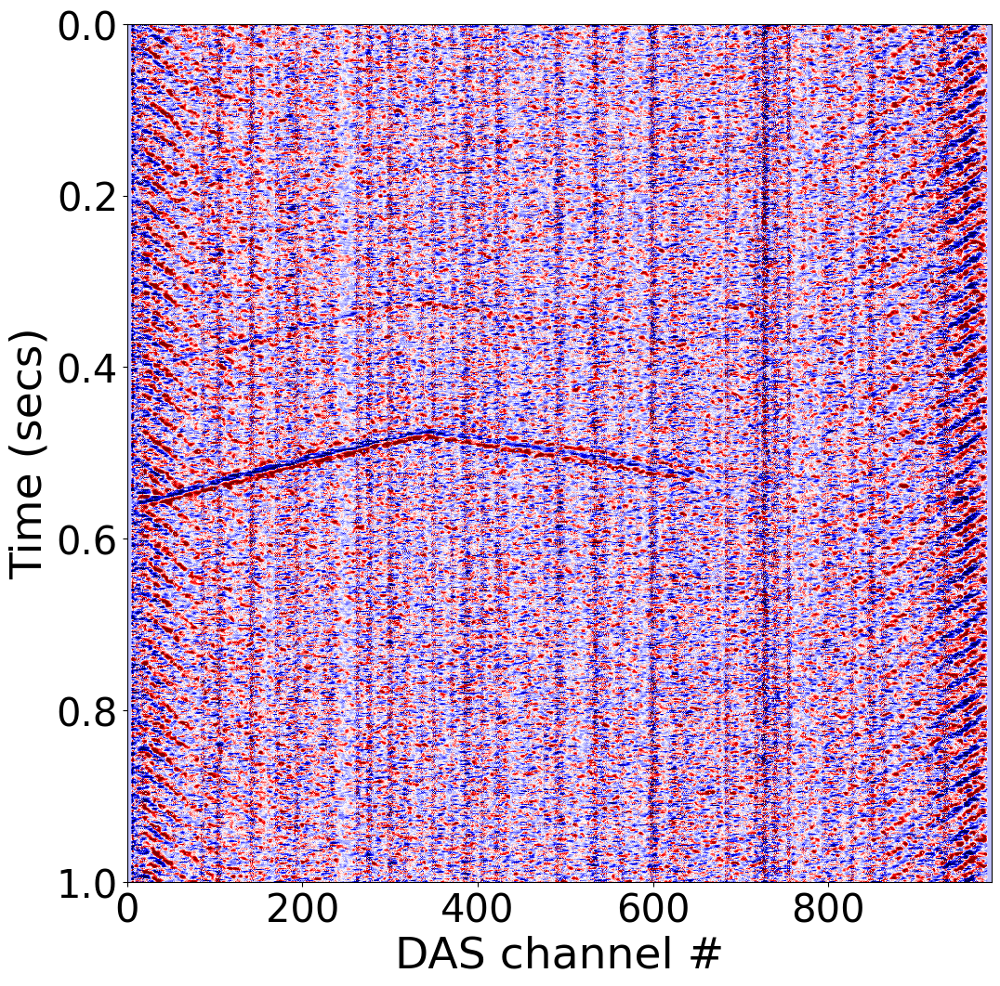

In [20]:
# Plot jDAS processed data
plt.imshow(st_jdas[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

## 6. Compare with pre-trained jDAS from original paper's GitHub repo (https://github.com/martijnende/jDAS)

In [21]:
# Application of original pre-trained jDAS (van den Ende et al., 2021) from GitHub repo:
!git clone https://github.com/martijnende/jDAS.git

Cloning into 'jDAS'...
remote: Enumerating objects: 142, done.
remote: Counting objects: 100% (142/142), done.
remote: Compressing objects: 100% (102/102), done.
remote: Total 142 (delta 65), reused 104 (delta 33), pack-reused 0
Receiving objects: 100% (142/142), 14.86 MiB | 16.80 MiB/s, done.
Resolving deltas: 100% (65/65), done.


In [22]:
# Load original pre-trained jDAS model
from jDAS.jDAS import JDAS
jdas_orig = JDAS()
jdas_orig_model = jdas_orig.load_model()

In [23]:
# Run original pre-trained jDAS model on raw data
jdas_clean_data = jdas_orig.denoise(np.swapaxes(st_raw_array,0,1), postfilter=False)

31/31 [==============================] - 2s 31ms/step


[]

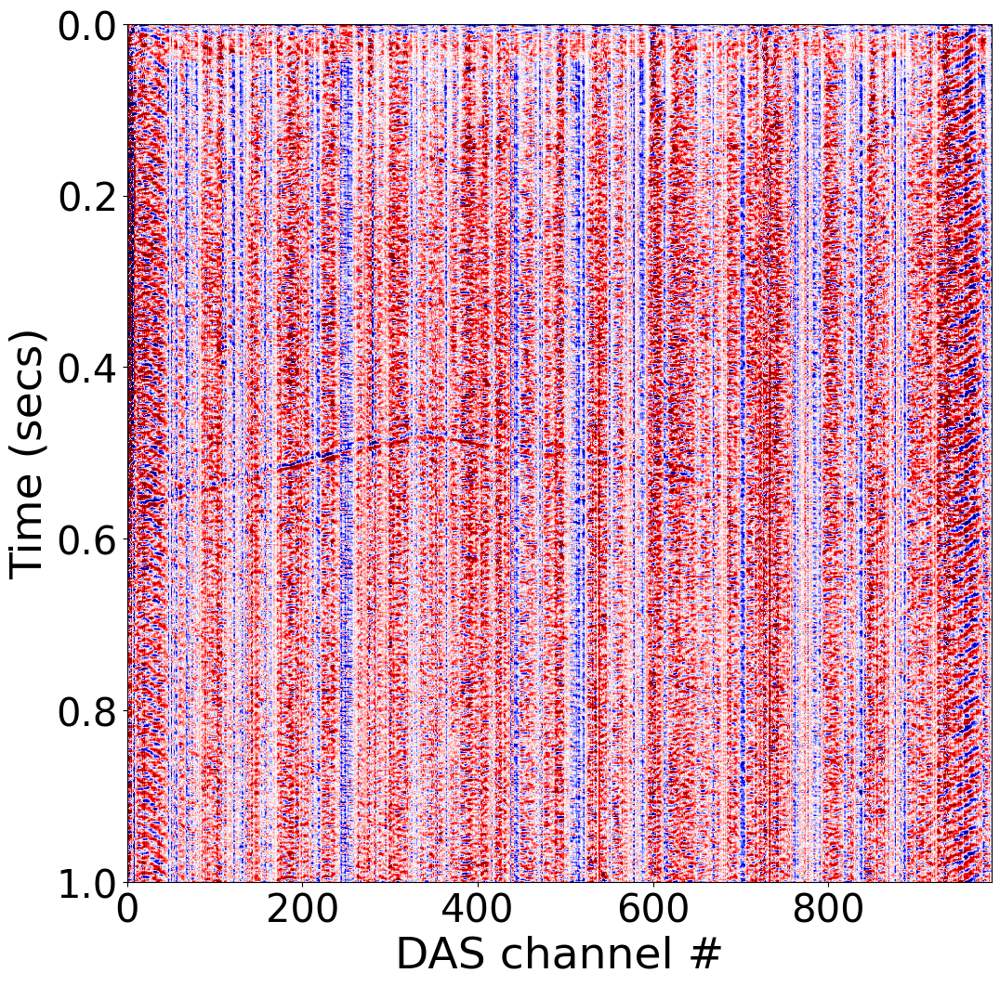

In [24]:
# Plot original pre-trained jDAS model processed data
plt.imshow(np.swapaxes(jdas_clean_data,0,1)[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

## 7. Plot individual channel trace with spectrogram for each method

In [25]:
import scipy
plt.rcParams["figure.figsize"] = (12,14) # Fig size
channel_no = 255
arrival1 = 328/1000 # Arrival time in sec
arrival2 = 480/1000 # Arrival time in sec

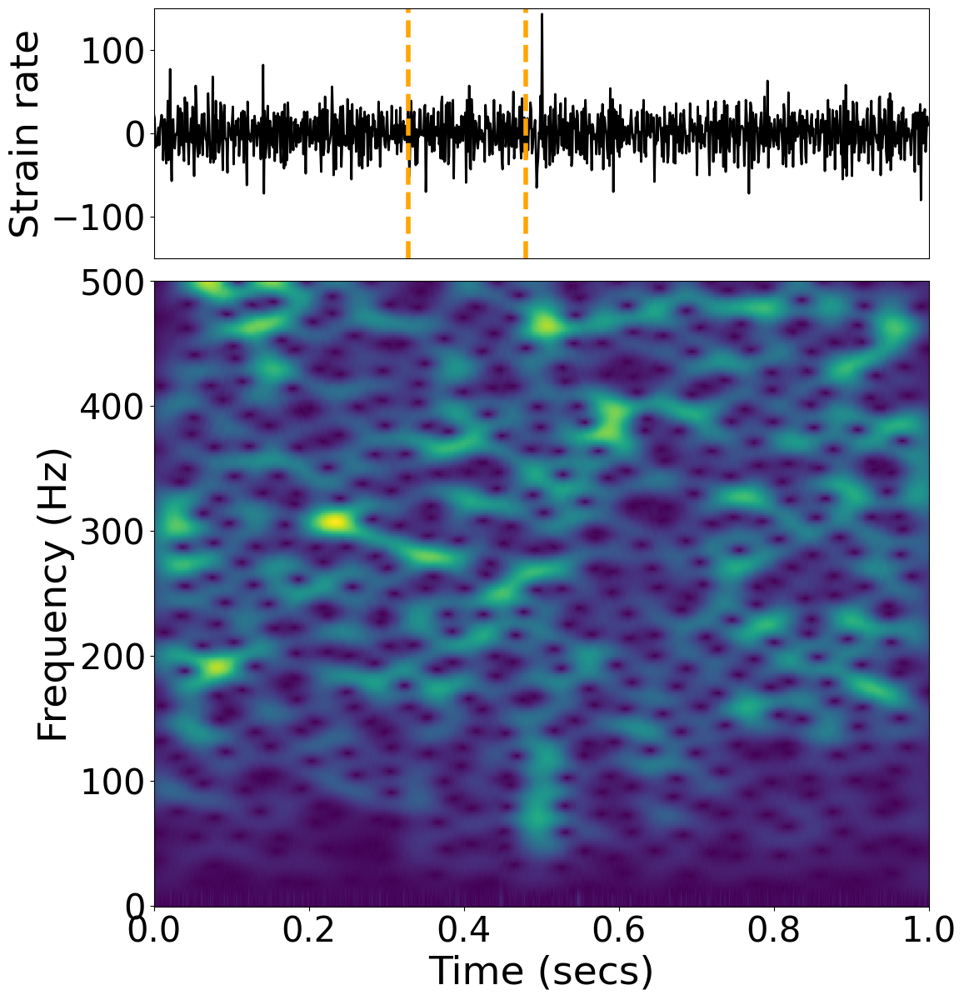

In [26]:
# Raw data
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_raw_array[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_raw_array[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_raw_array[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

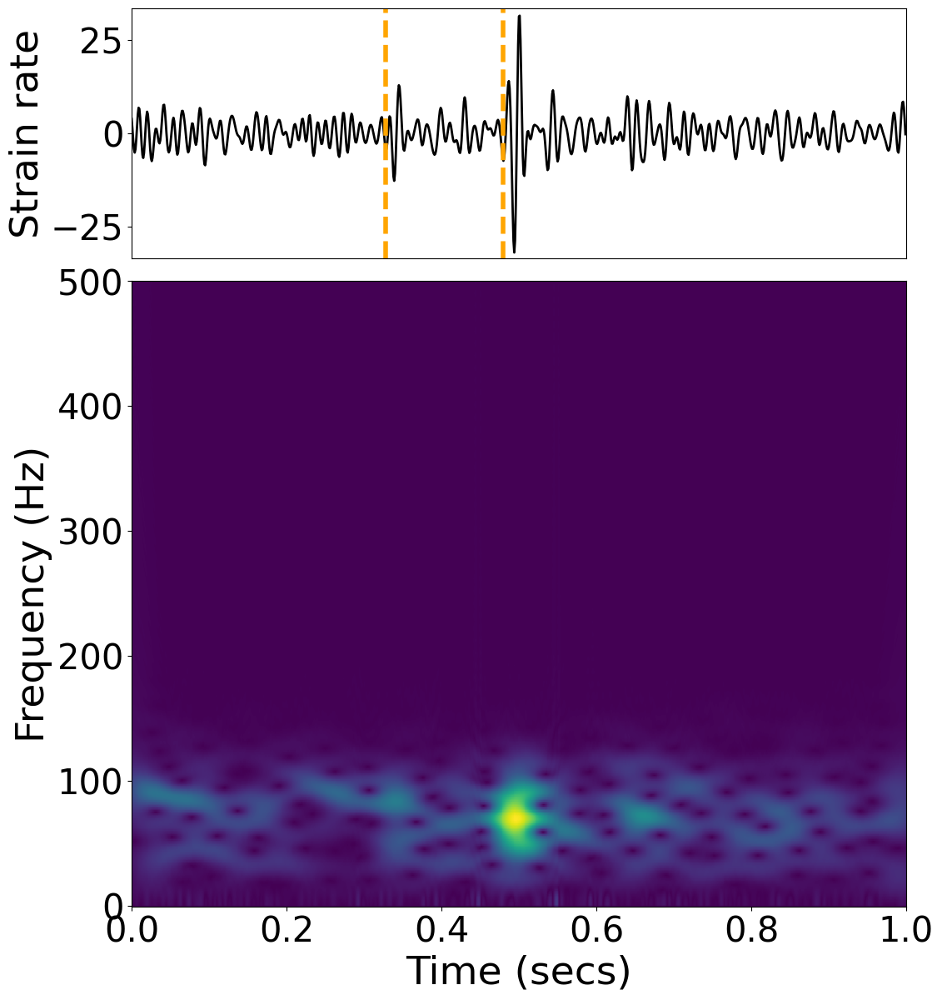

In [27]:
# BP filtered data
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_bp_array[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_bp_array[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_bp_array[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

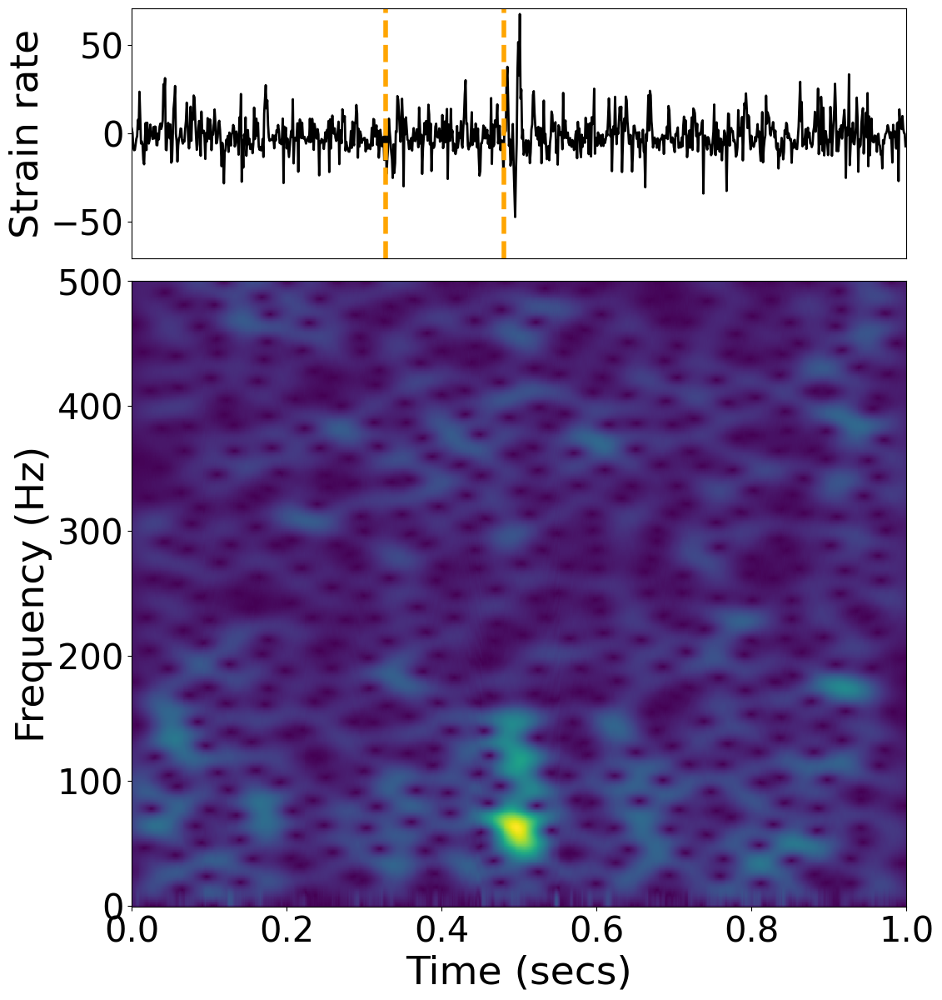

In [28]:
# jDAS (3-layer Unet)
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_jdas[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_jdas[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_jdas[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

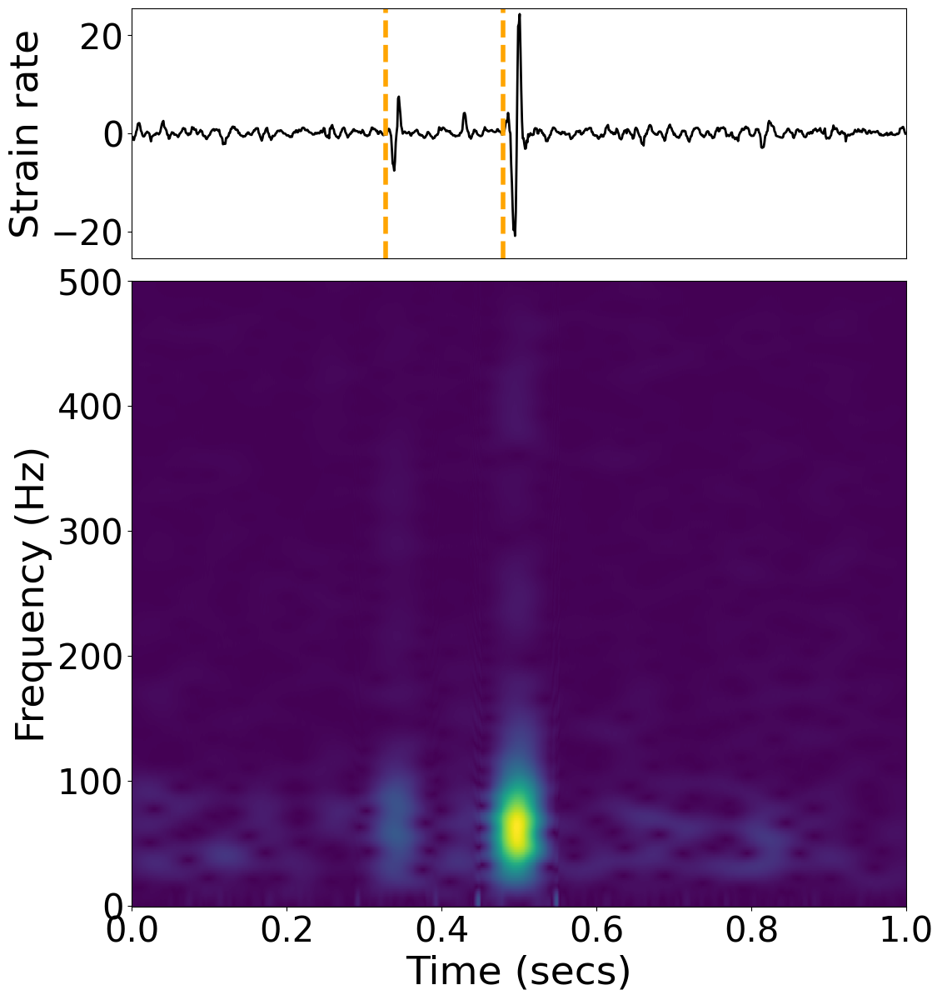

In [29]:
# DAS-N2N (3-layer Unet)
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_dasn2n[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_dasn2n[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_dasn2n[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

## 8. Compute local SNR for each method

In [30]:
from scipy.signal import correlate

In [31]:
# Works on older versions of scipy
def correlate_func(x, idx, cc_thresh = 0.9):
    correlation = correlate(x[idx,:], x[(idx+1),:], mode="full")
    lags = np.arange(-(x[idx,:].size - 1), x[(idx+1),:].size)
    lag_idx = np.argmax(correlation)
    lag = lags[lag_idx]
    if lag > 0:
        if np.corrcoef(x[idx,lag:], x[(idx+1),:-lag], rowvar=False)[0,1] > cc_thresh:
            x = np.concatenate(
                [np.concatenate([x[:(idx+1),:], np.zeros((x[:(idx+1),:].shape[0], lag))], axis=1), 
                 np.concatenate([np.zeros((x[(idx+1):,:].shape[0], lag)), x[(idx+1):,:]], axis=1)], 
                axis=0)
    if lag < 0:
        if np.corrcoef(x[idx,:-lag], x[(idx+1),lag:], rowvar=False)[0,1] > cc_thresh:
            x = np.concatenate(
                [np.concatenate([np.zeros((x[:(idx+1),:].shape[0], abs(lag))), x[:(idx+1),:]], axis=1), 
                 np.concatenate([x[(idx+1):,:], np.zeros((x[(idx+1):,:].shape[0], abs(lag)))], axis=1)], 
                axis=0)
            
    return(x)

# Looks at all previous channels in window and shifts relative to channel with highest xcorr
def correlate_func2(x, idx, cc_thresh = 0.9):
    correlation = correlate(x[:idx,:], x[(idx+1):(idx+2),:], mode="full", method="direct")
    idx_max_xcorr = np.argmax(np.amax(correlation, axis=1))
    
    lags = np.arange(-(x[idx_max_xcorr,:].size - 1), x[(idx+1),:].size)
    lag_idx = np.argmax(correlation[idx_max_xcorr,:])
    lag = lags[lag_idx]
    
    if lag > 0:
        if np.corrcoef(x[idx_max_xcorr,lag:], x[(idx+1),:-lag], rowvar=False)[0,1] > cc_thresh:
            # Need to check difference in zeros at start
            idx_max_xcorr_start = np.amin(np.where(x[idx_max_xcorr,:] != 0))
            idx_plus1_start = np.amin(np.where(x[(idx+1),:] != 0))
            lag = lag - (idx_plus1_start - idx_max_xcorr_start)
            if lag > 0:
                # Concatenate zeros to shift signal
                x = np.concatenate(
                    [np.concatenate([x[:(idx+1),:], np.zeros((x[:(idx+1),:].shape[0], lag))], axis=1), 
                     np.concatenate([np.zeros((x[(idx+1):,:].shape[0], lag)), x[(idx+1):,:]], axis=1)], 
                    axis=0)
    if lag < 0:
        if np.corrcoef(x[idx,:-lag], x[(idx+1),lag:], rowvar=False)[0,1] > cc_thresh:
            # Need to check difference in zeros at start
            idx_max_xcorr_start = np.amin(np.where(x[idx_max_xcorr,:] != 0))
            idx_plus1_start = np.amin(np.where(x[(idx+1),:] != 0))
            lag = lag + (idx_plus1_start - idx_max_xcorr_start)
            if lag < 0:
                # Concatenate zeros to shift signal
                x = np.concatenate(
                    [np.concatenate([np.zeros((x[:(idx+1),:].shape[0], abs(lag))), x[:(idx+1),:]], axis=1), 
                     np.concatenate([x[(idx+1):,:], np.zeros((x[(idx+1):,:].shape[0], abs(lag)))], axis=1)], 
                    axis=0)
            
    return(x)

In [32]:
# Functions for calculating semblance
# (adapted from https://github.com/seg/tutorials-2015/blob/master/1512_Semblance_coherence_and_discontinuity/Discontinuity_tutorial.ipynb)

import scipy.ndimage
import scipy.signal
import matplotlib.patches as patches
from matplotlib.patches import Patch

def moving_window(data, window, func):
    wrapped = lambda region: func(region.reshape(window))
    return scipy.ndimage.generic_filter(data, wrapped, window)

# This is equal to first part of Eq 7 in https://doi.org/10.1111/1365-2478.13178
def marfurt_semblance(region):
    region = region.reshape(-1, region.shape[-1])
    ntraces, nsamples = region.shape
    
    # Cross correlation and shift
    for i in range(ntraces-1):
        region = correlate_func(region, i, cc_thresh = 0.7)
    
    square_of_sums = np.sum(region, axis=0)**2
    sum_of_squares = np.sum(region**2, axis=0)
    sembl = square_of_sums.sum() / sum_of_squares.sum()
    return sembl / ntraces

In [33]:
no_chan = 13
no_samp = 19 # Larger to accommodate cross-correlation shifts

In [34]:
# Calculate semblance for raw data
S_raw_ex = moving_window(np.swapaxes(st_raw_array[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_raw_ex = np.swapaxes(S_raw_ex, 0, 1)

/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2829: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2830: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


In [35]:
# Calculate semblance for BP filtered data
S_bp_ex = moving_window(np.swapaxes(st_bp_array[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_bp_ex = np.swapaxes(S_bp_ex, 0, 1)

In [36]:
# Calculate semblance for DAS-N2N processed data
S_n2n_ex = moving_window(np.swapaxes(st_dasn2n[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_n2n_ex = np.swapaxes(S_n2n_ex, 0, 1)

In [37]:
# Calculate semblance for jDAS (3-layer Unet) processed data
S_jdas_ex = moving_window(np.swapaxes(st_jdas[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_jdas_ex = np.swapaxes(S_jdas_ex, 0, 1)

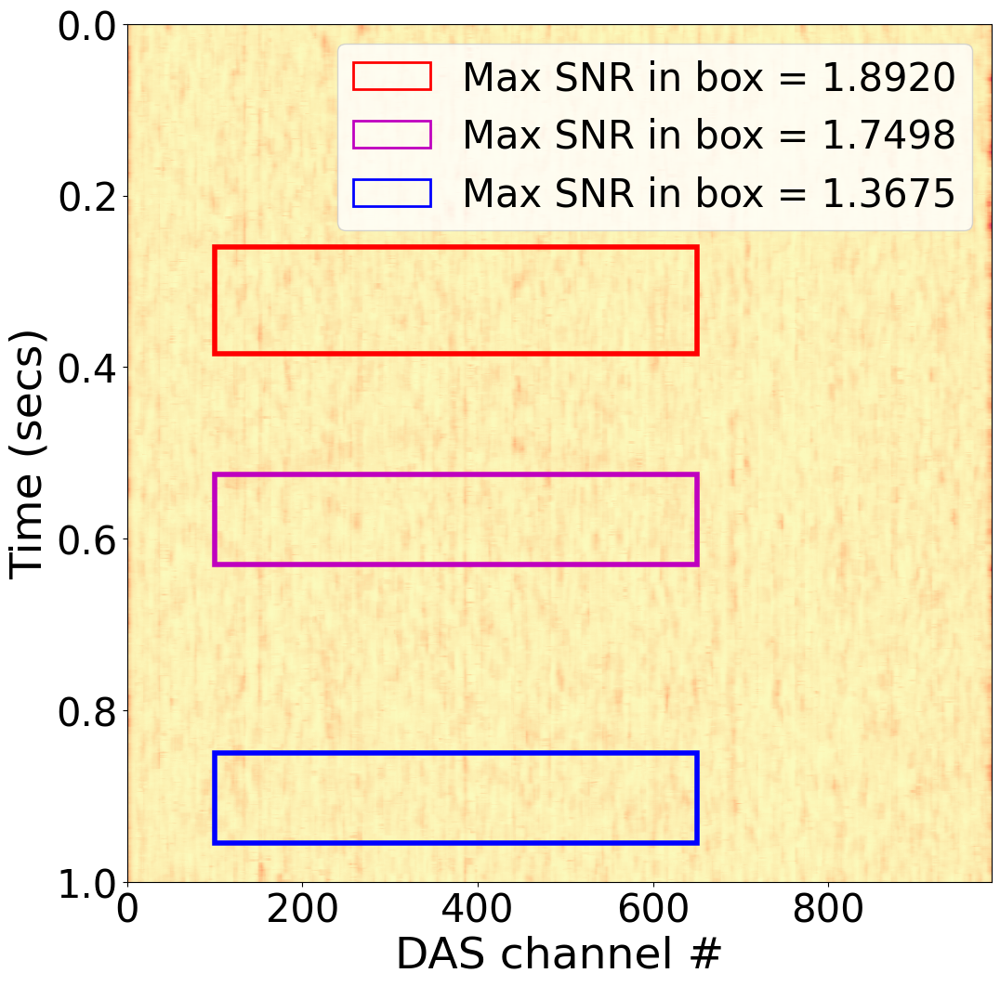

In [38]:
# Plot local SNR for raw data

plt.rcParams["figure.figsize"] = (12,12) # Fig size

# Create figure and axes
S = S_raw_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

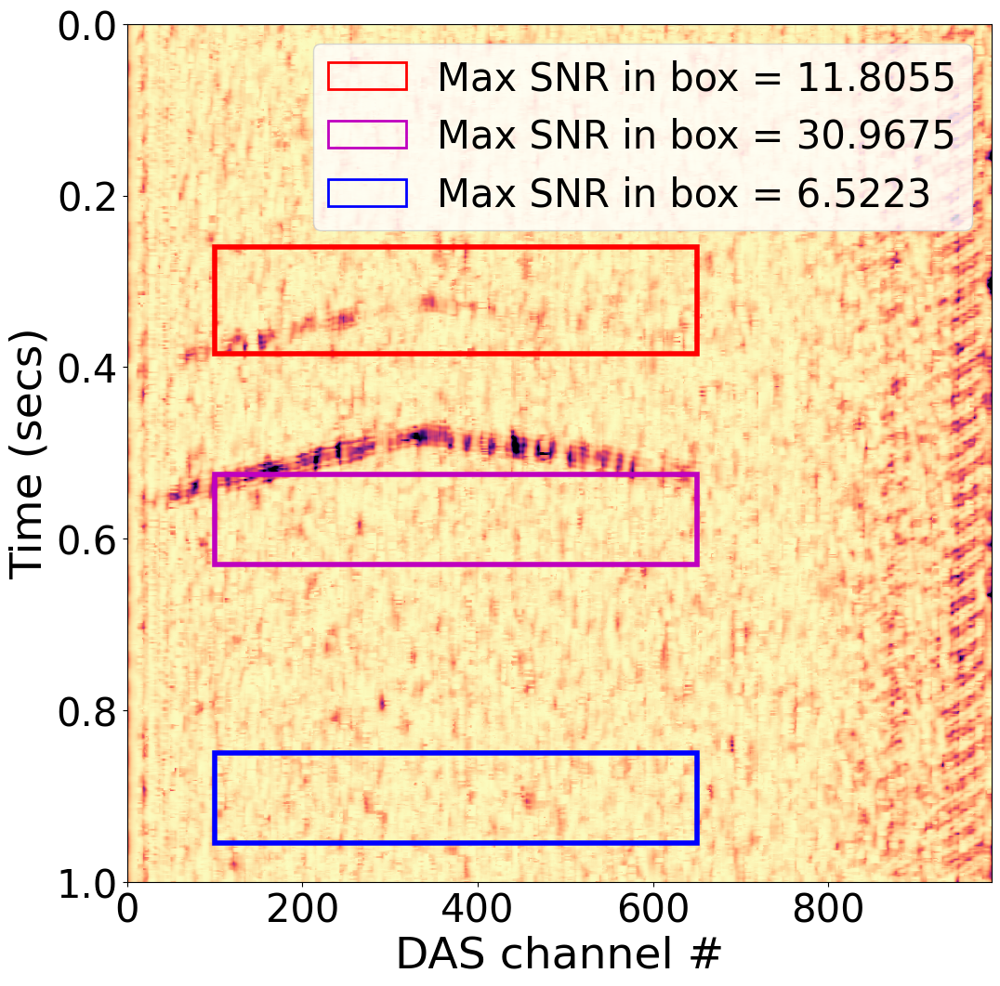

In [39]:
# Plot local SNR for BP filtered data

# Create figure and axes
S = S_bp_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

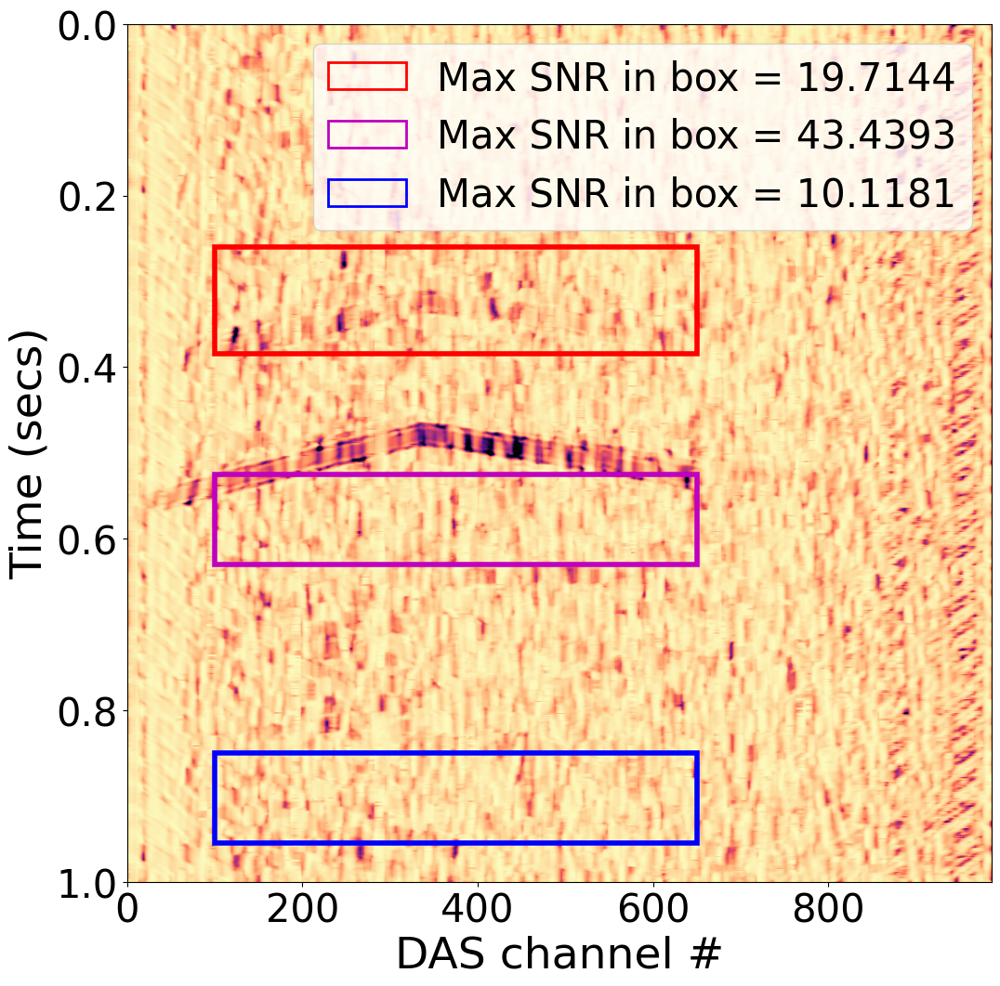

In [40]:
# Plot local SNR for DAS-N2N processed data

# Create figure and axes
S = S_n2n_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

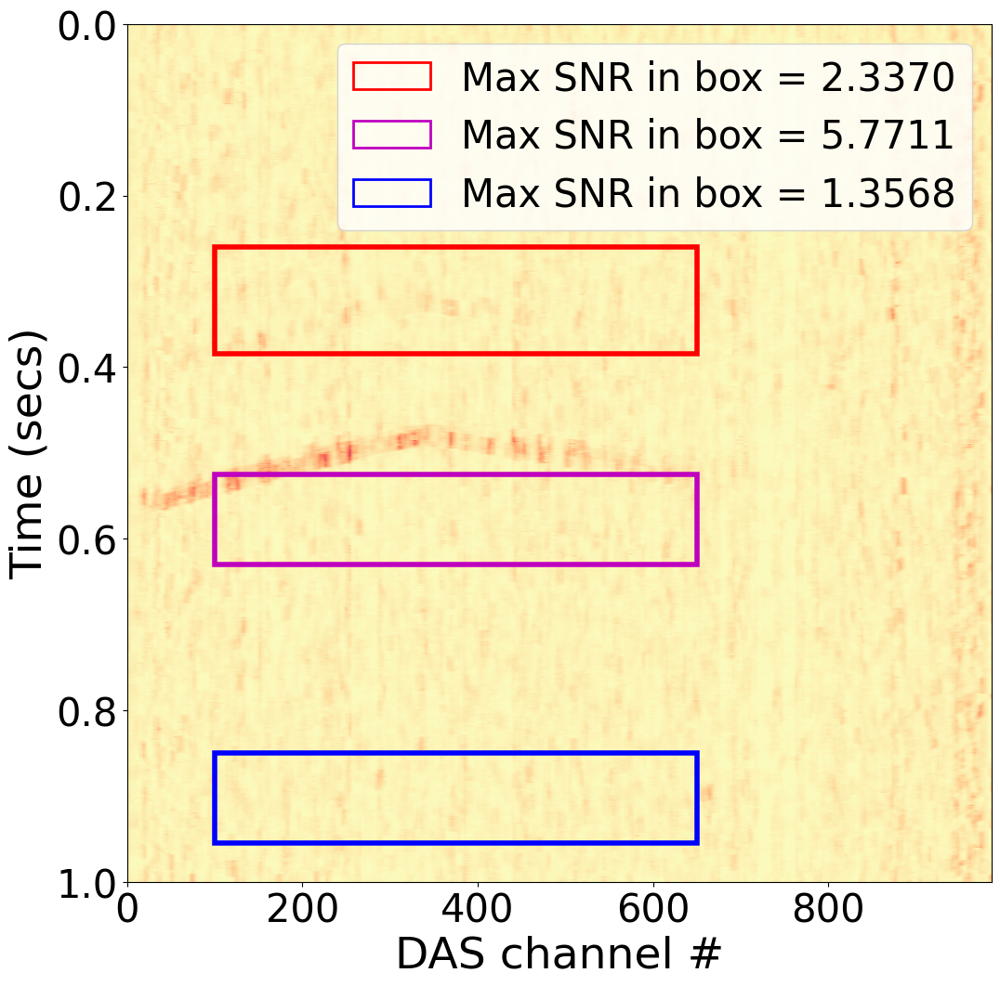

In [41]:
# Plot local SNR for jDAS data

# Create figure and axes
S = S_jdas_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

## 9. Repeat all of the above for second example (Example \#2 from paper)

In [42]:
# Read in first event, cut and save tdms
example2 = "DAS-N2N/data/BPT1_UTC_20200117_044207.903.mseed"
st_raw = read(example2)

In [43]:
st_raw

986 Trace(s) in Stream:

BP.D0000..Z | 2020-01-17T04:42:07.903000Z - 2020-01-17T04:42:09.950000Z | 1000.0 Hz, 2048 samples
...
(984 other traces)
...
BP.D0985..Z | 2020-01-17T04:42:07.903000Z - 2020-01-17T04:42:09.950000Z | 1000.0 Hz, 2048 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [44]:
st_raw_array = np.swapaxes(utils.stream2array(st_raw), 0, 1)
st_raw_array -= np.mean(st_raw_array)

In [45]:
# Apply BP filter (10 - 100 Hz)
st_bp = st_raw.copy()

print("Before bandpass: " + str(datetime.now()))
before = datetime.now()
st_bp.detrend("demean")
st_bp.filter("bandpass", freqmin=10, freqmax=100, zerophase=True)
print("After bandpass: " + str(datetime.now()))
st_bp_array = np.swapaxes(utils.stream2array(st_bp), 0, 1)
st_bp_array -= np.mean(st_bp_array)

Before bandpass: 2023-04-19 16:03:08.085142
After bandpass: 2023-04-19 16:03:09.458275


[]

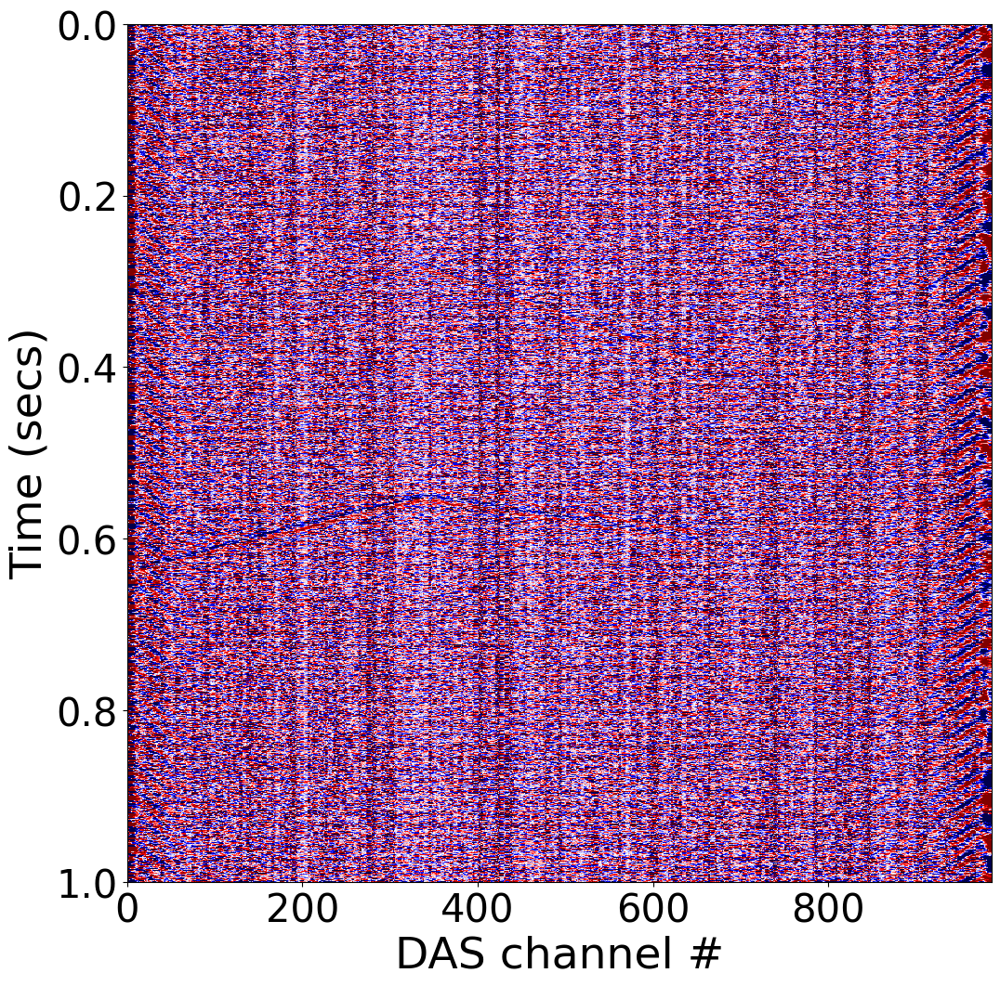

In [46]:
# Plot raw data
plt.rcParams["figure.figsize"] = (12,12) # Fig size

plt.imshow(st_raw_array[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

[]

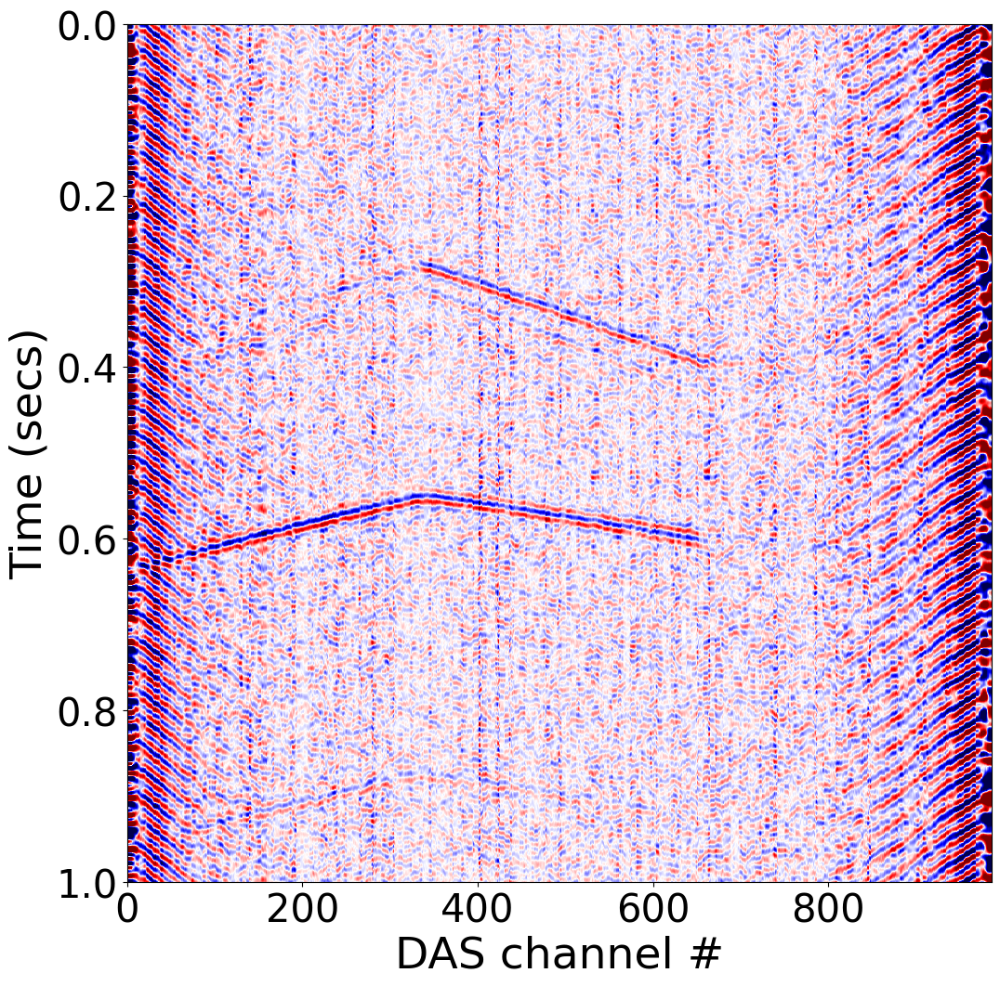

In [47]:
# Plot BP filtered data
plt.imshow(st_bp_array[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

In [48]:
# Apply DAS-N2N model to raw data
st_dasn2n = run_dasn2n_on_stream(st_raw.copy(), dasn2n, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, overlap = False)

Start function: 2023-04-19 16:03:11.527017
After converting stream to array: 2023-04-19 16:03:11.534327
After normalising data: 2023-04-19 16:03:11.546953
After padding and reshaping data: 2023-04-19 16:03:11.557913
After running model: 2023-04-19 16:03:11.830199
After re-scaling predictions and reshaping back to original signal dims: 2023-04-19 16:03:11.836723


[]

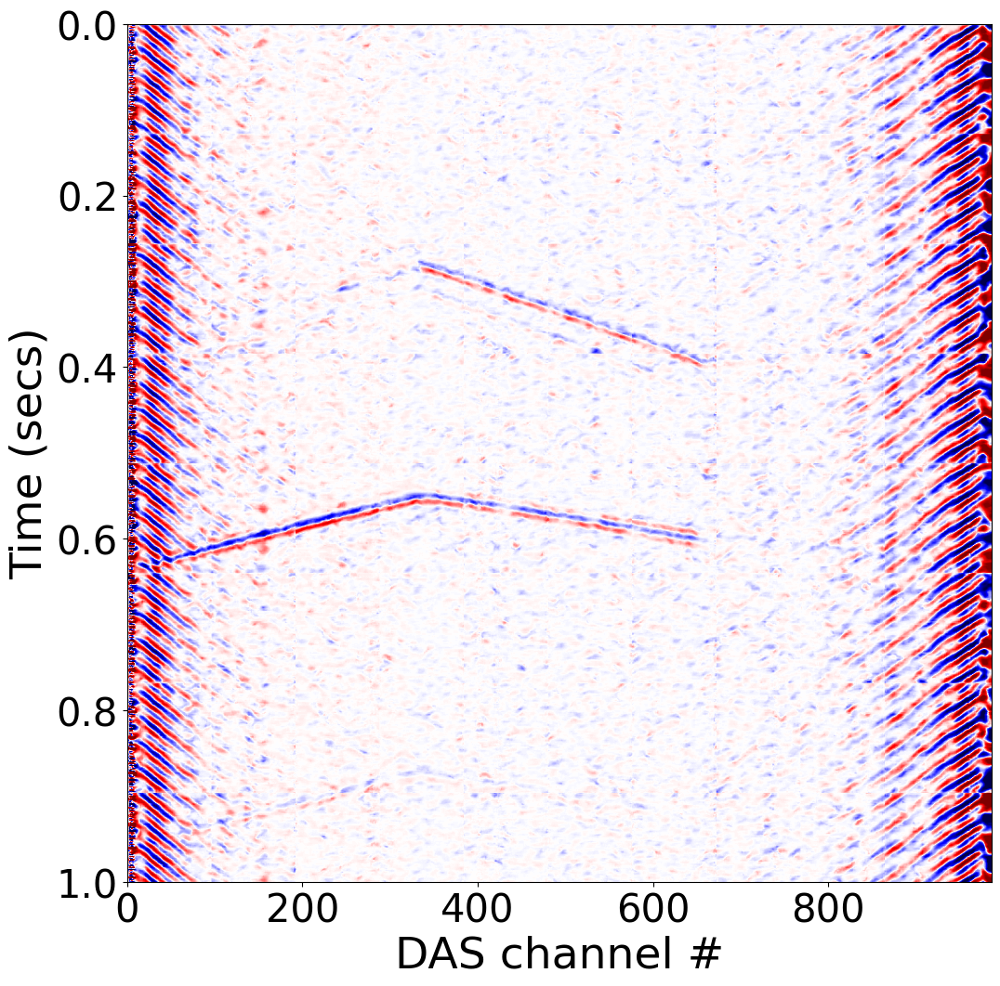

In [49]:
# Plot DAS-N2N processed data
plt.imshow(st_dasn2n[:1000,], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

In [50]:
# Apply jDAS (3-layer Unet implementation) to raw data
st_jdas = run_jdas_on_stream(st_raw.copy(), jdas, normalise_whole_signal=True, normalise_with_std=True, return_as_stream = False, swapaxes=False)

Start function: 2023-04-19 16:03:12.651363
After converting stream to array: 2023-04-19 16:03:12.659278
After normalising data: 2023-04-19 16:03:12.671693
After padding and reshaping data: 2023-04-19 16:03:13.445668
After running model: 2023-04-19 16:03:19.243967
After re-scaling predictions and reshaping back to original signal dims: 2023-04-19 16:03:20.309835


[]

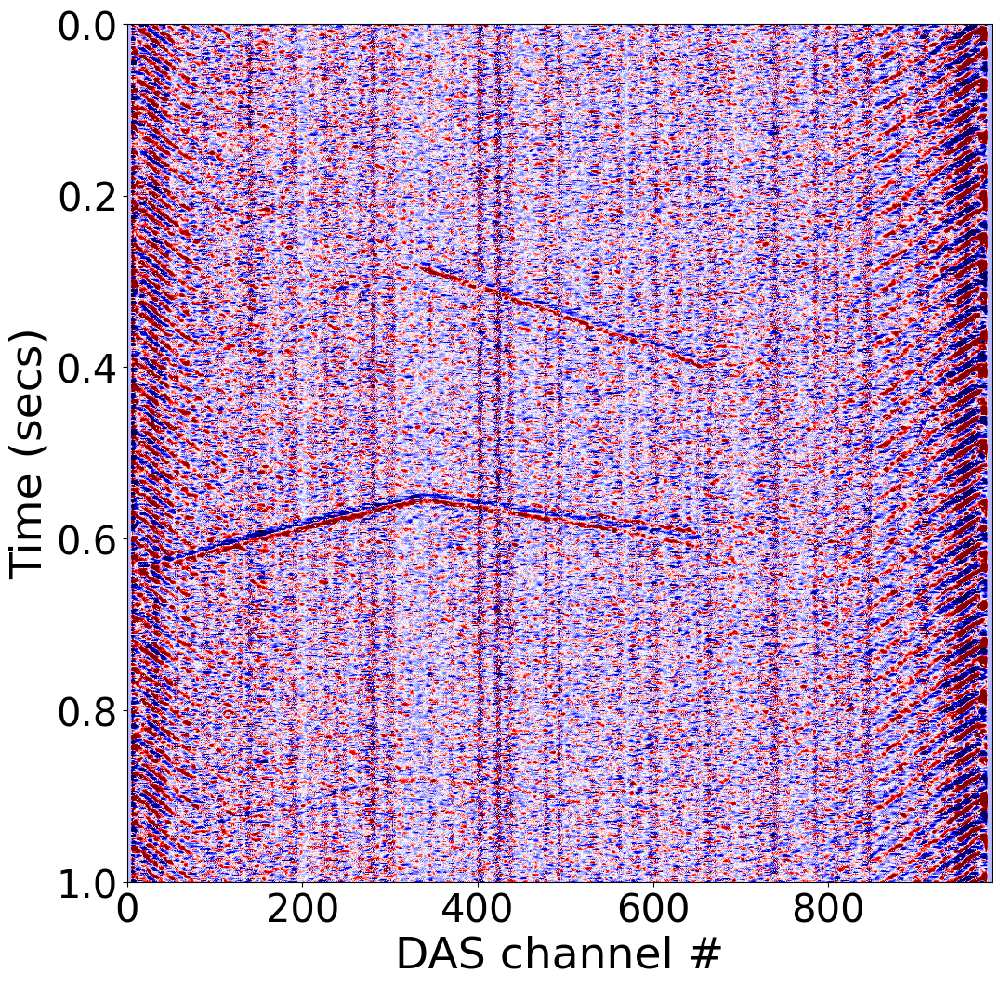

In [51]:
# Plot jDAS processed data
plt.imshow(st_jdas[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

In [52]:
# Apply original pre-trained jDAS to raw data
jdas_clean_data = jdas_orig.denoise(np.swapaxes(st_raw_array,0,1), postfilter=False)

31/31 [==============================] - 1s 17ms/step


[]

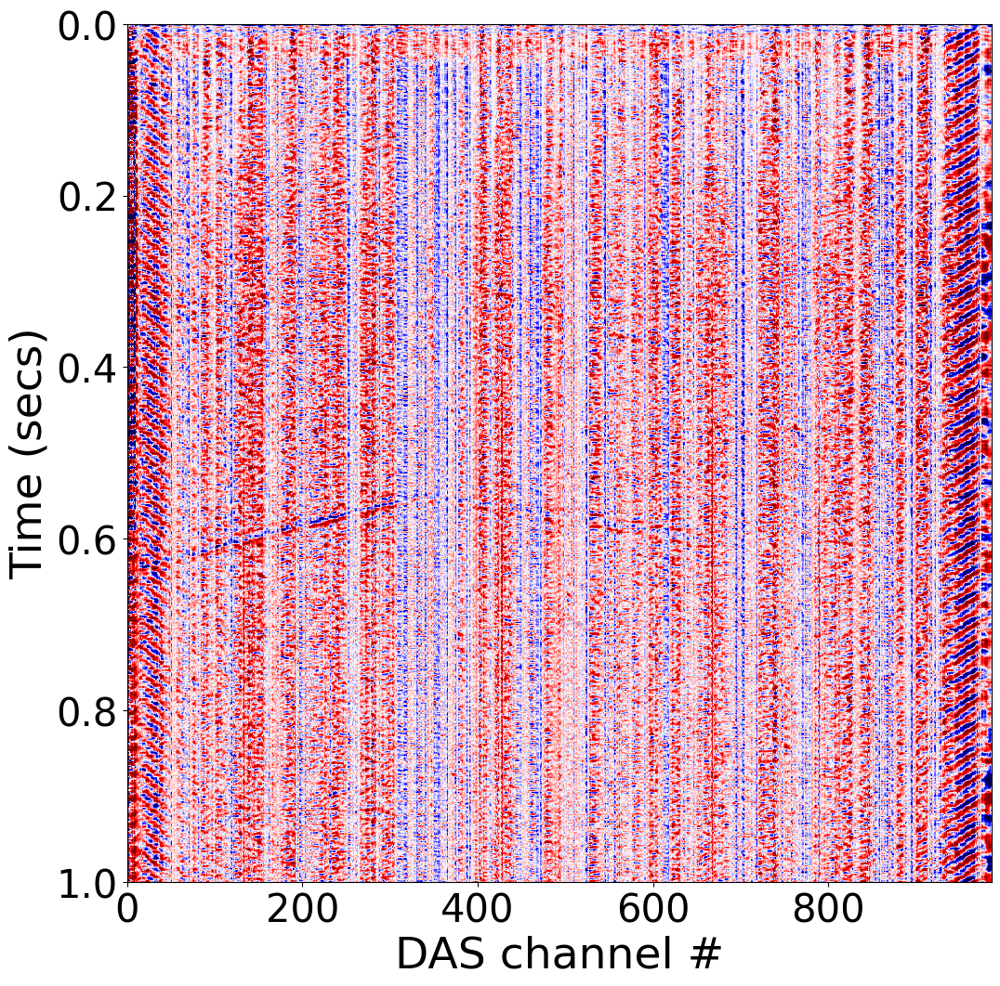

In [53]:
# Plot original pre-trained jDAS processed data
plt.imshow(np.swapaxes(jdas_clean_data,0,1)[:1000,:], vmin=-40, vmax=40, cmap="seismic", aspect="auto", extent=[0,len(st_raw),1,0])
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.plot()

### Spectrogram plots...

In [54]:
plt.rcParams["figure.figsize"] = (12,14) # Fig size

channel_no = 587
arrival1 = 357/1000
arrival2 = 567/1000
arrival3 = 902/1000

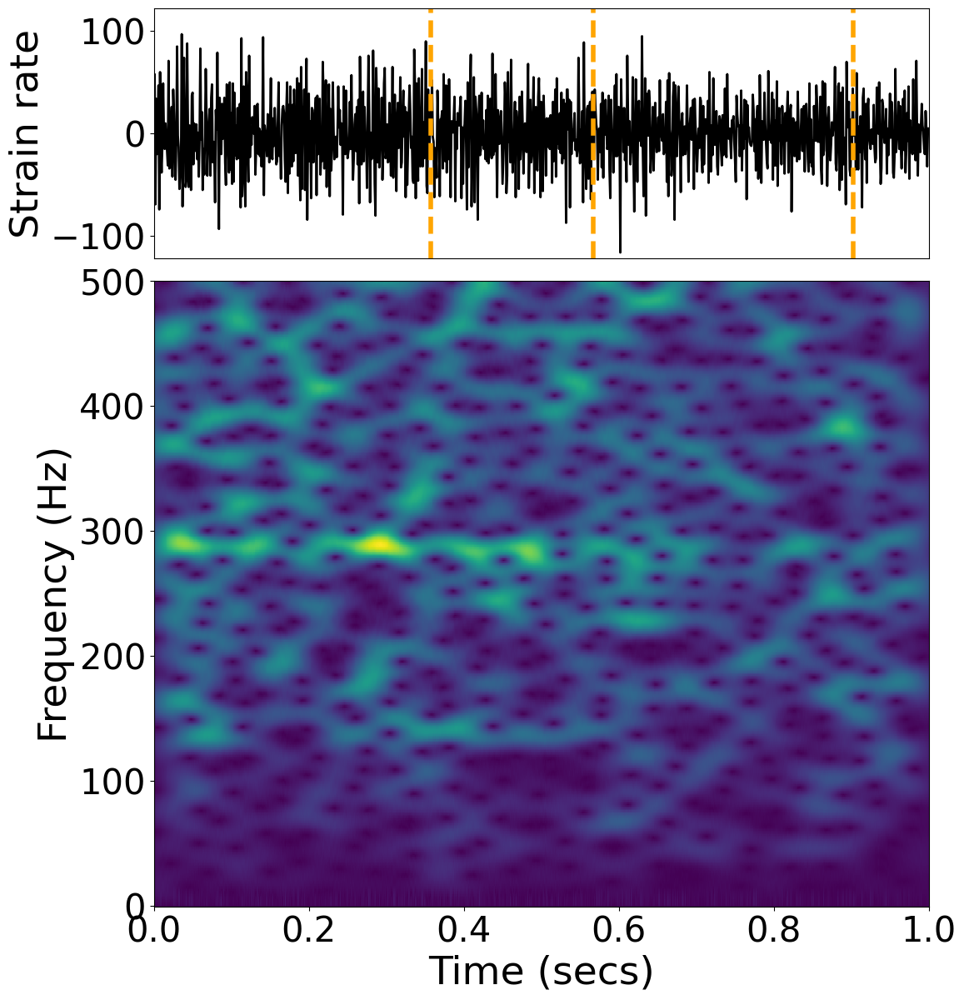

In [55]:
# Raw data
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_raw_array[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival3, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_raw_array[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_raw_array[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

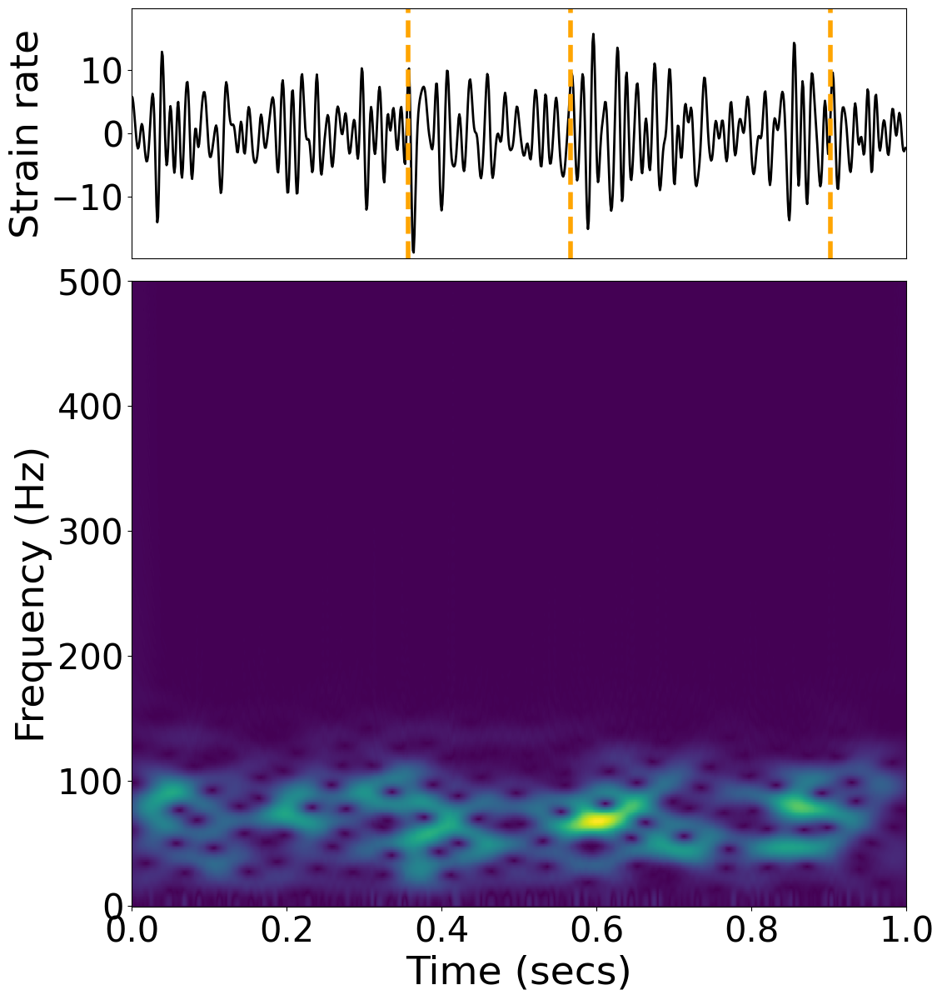

In [56]:
# BP filtered data
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_bp_array[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival3, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_bp_array[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_bp_array[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

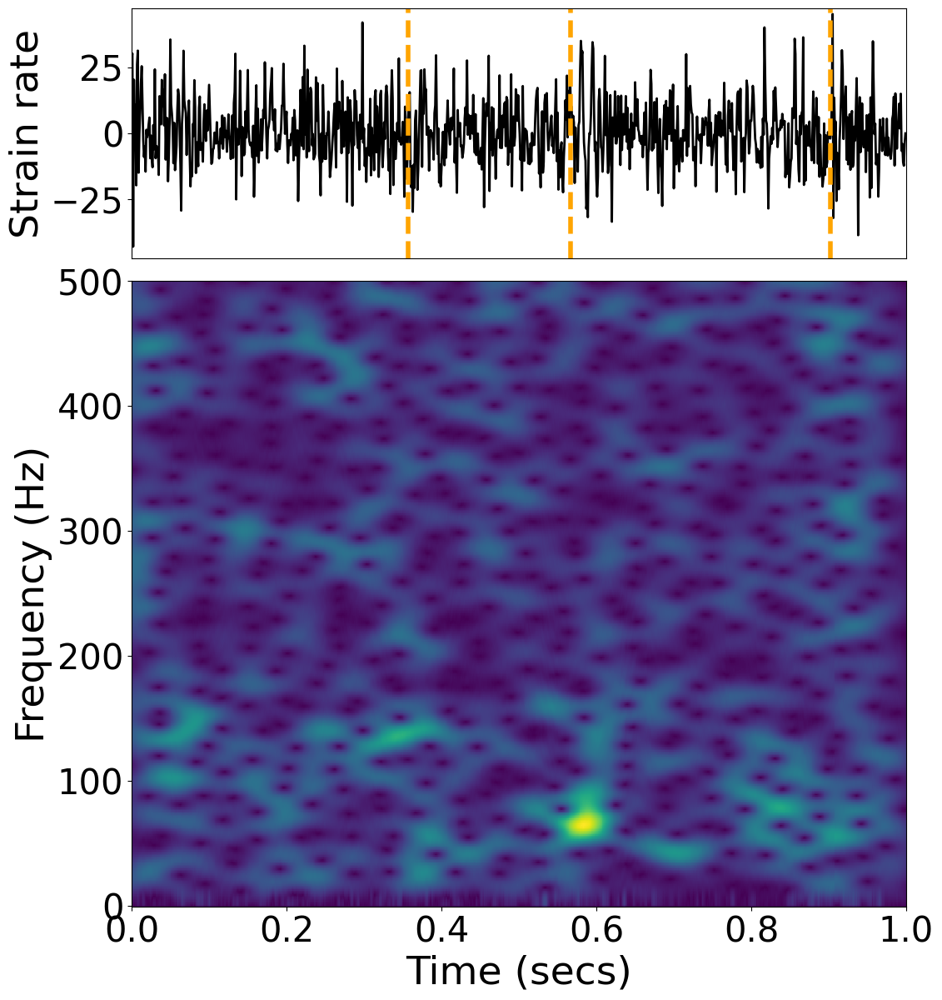

In [57]:
# jDAS (3-layer Unet)
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_jdas[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival3, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_jdas[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_jdas[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

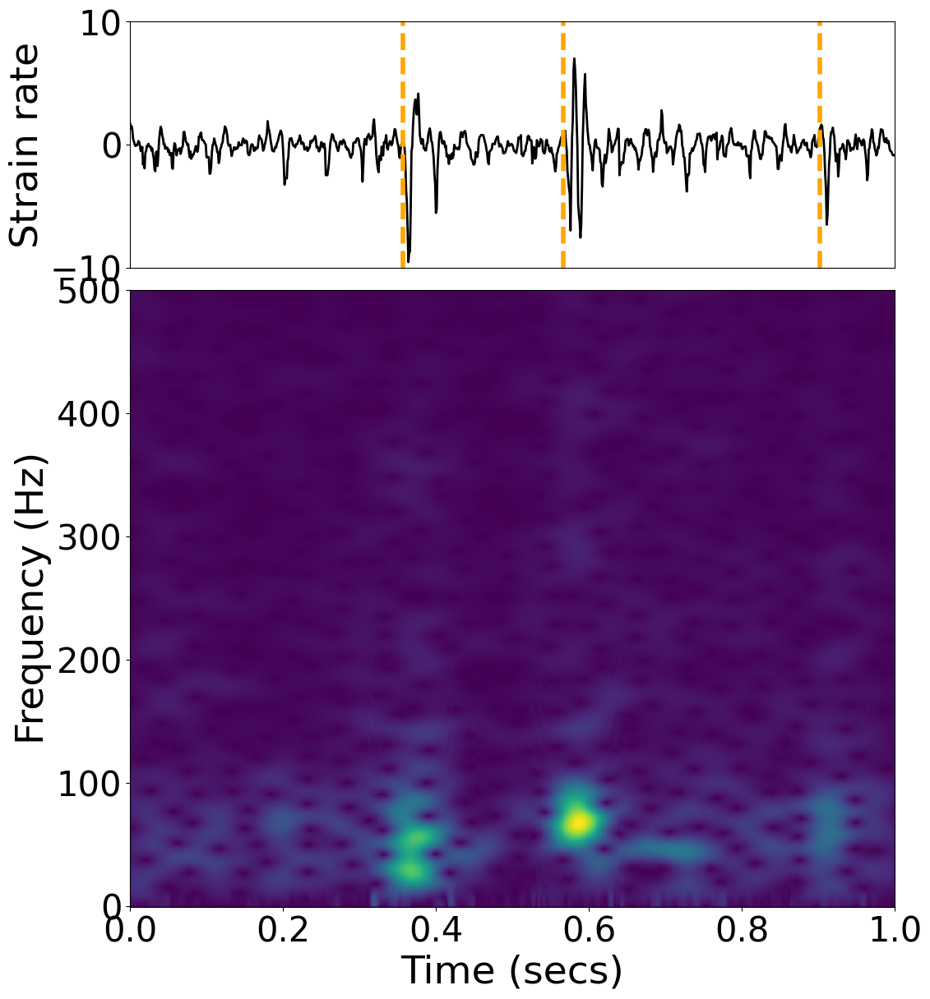

In [58]:
# DAS-N2N data
fig, axs = plt.subplots(2, gridspec_kw={'height_ratios': [1, 2.5]})
axs[0].plot(np.arange(0, 1000)/1000, st_dasn2n[:1000,channel_no], color='k', linewidth=2)
axs[0].axvline(x=arrival1, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival2, ls='--', color="orange", linewidth=4)
axs[0].axvline(x=arrival3, ls='--', color="orange", linewidth=4)
ylim = np.amax(abs(st_dasn2n[:1000,channel_no])) * 1.05
axs[0].set_ylim(-ylim, ylim)
axs[0].set_xlim(0, 1)
axs[0].tick_params(labelsize=30)
axs[0].set_ylabel("Strain rate", fontsize=34)
axs[0].axes.xaxis.set_visible(False)

f, t, Sxx = scipy.signal.spectrogram(np.pad(st_dasn2n[:1000,channel_no], (50,50), "constant"), fs=1000, window = scipy.signal.windows.hamming(101), noverlap=100, nfft=1024, scaling='spectrum')
axs[1].pcolormesh(t-0.05, f, Sxx**(1/2), cmap="viridis")
axs[1].set_ylabel('Frequency (Hz)', fontsize=34)
axs[1].set_xlabel('Time (secs)', fontsize = 34)
axs[1].tick_params(labelsize=30)

plt.subplots_adjust(wspace=0, hspace=0.05)

plt.show()

### Local SNR...

In [59]:
# Calculate semblance for raw data
S_raw_ex = moving_window(np.swapaxes(st_raw_array[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_raw_ex = np.swapaxes(S_raw_ex, 0, 1)

In [60]:
# Calculate semblance for BP filtered data
S_bp_ex = moving_window(np.swapaxes(st_bp_array[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_bp_ex = np.swapaxes(S_bp_ex, 0, 1)

In [61]:
# Calculate semblance for DAS-N2N processed data
S_n2n_ex = moving_window(np.swapaxes(st_dasn2n[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_n2n_ex = np.swapaxes(S_n2n_ex, 0, 1)

In [62]:
# Calculate semblance for jDAS (3-layer Unet) processed data
S_jdas_ex = moving_window(np.swapaxes(st_jdas[:1000,:], 0, 1), (no_chan, no_samp), marfurt_semblance)
S_jdas_ex = np.swapaxes(S_jdas_ex, 0, 1)

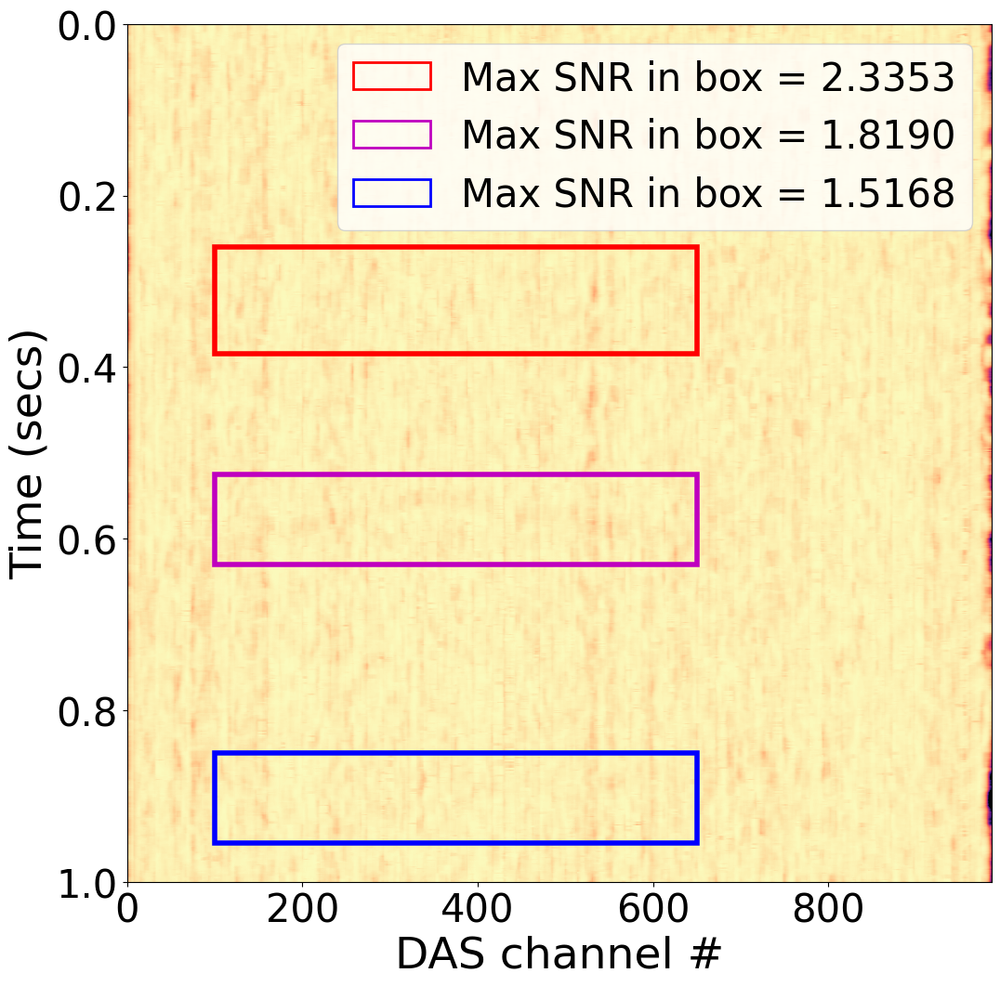

In [63]:
# Plot local SNR for raw data

plt.rcParams["figure.figsize"] = (12,12) # Fig size

# Create figure and axes
S = S_raw_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

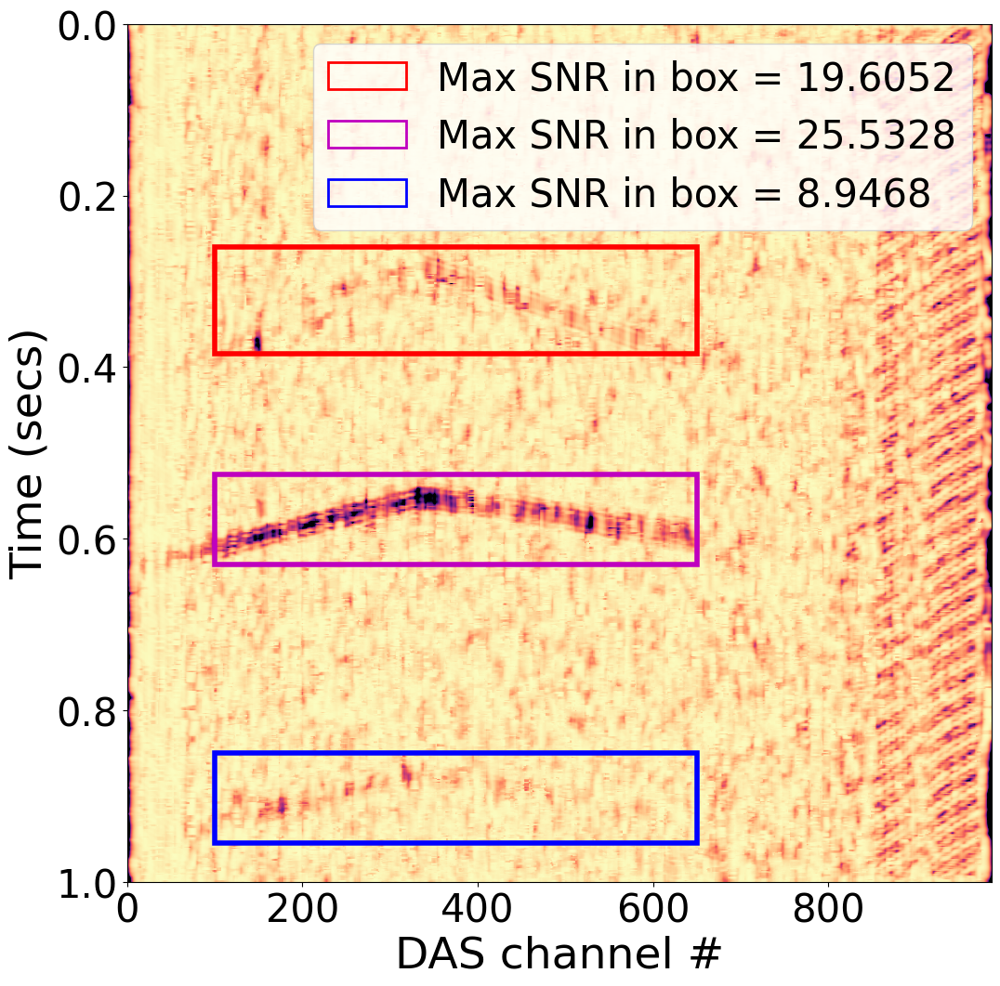

In [64]:
# Plot local SNR for BP filtered data

# Create figure and axes
S = S_bp_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

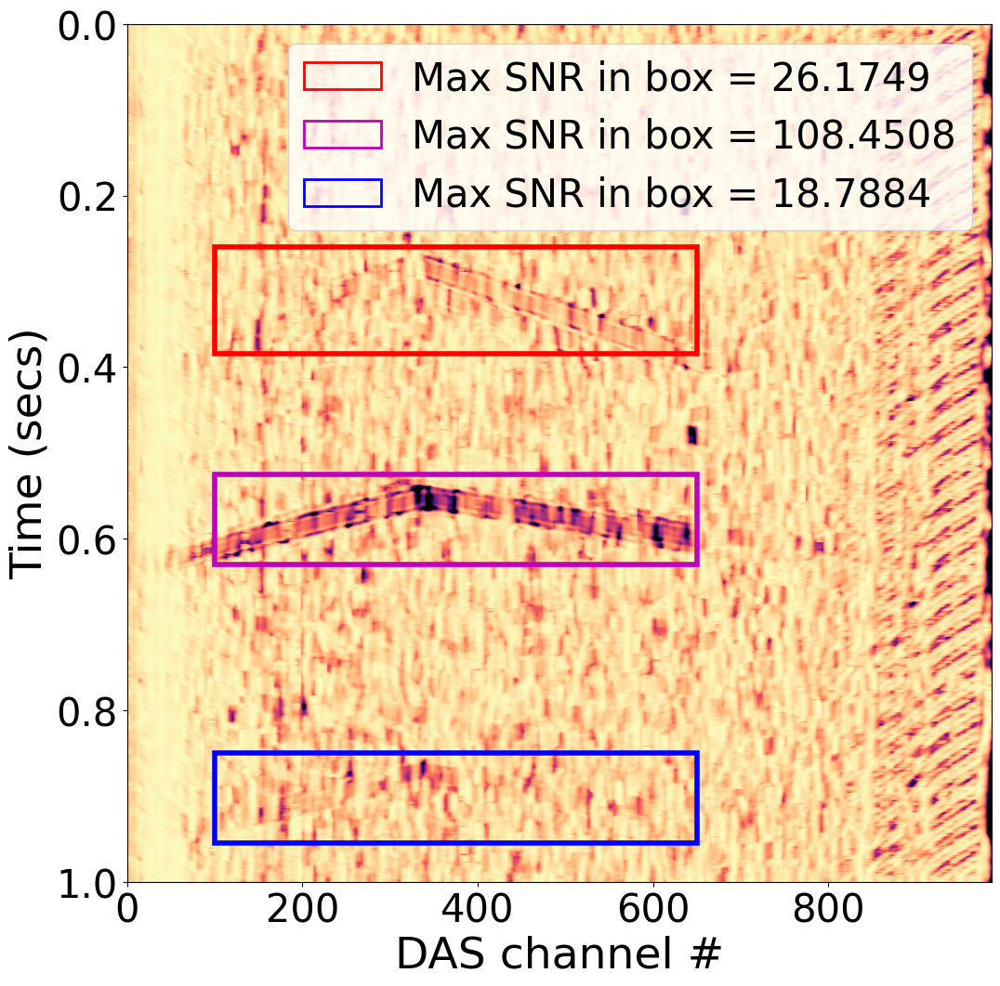

In [65]:
# Plot local SNR for DAS-N2N processed data

# Create figure and axes
S = S_n2n_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()

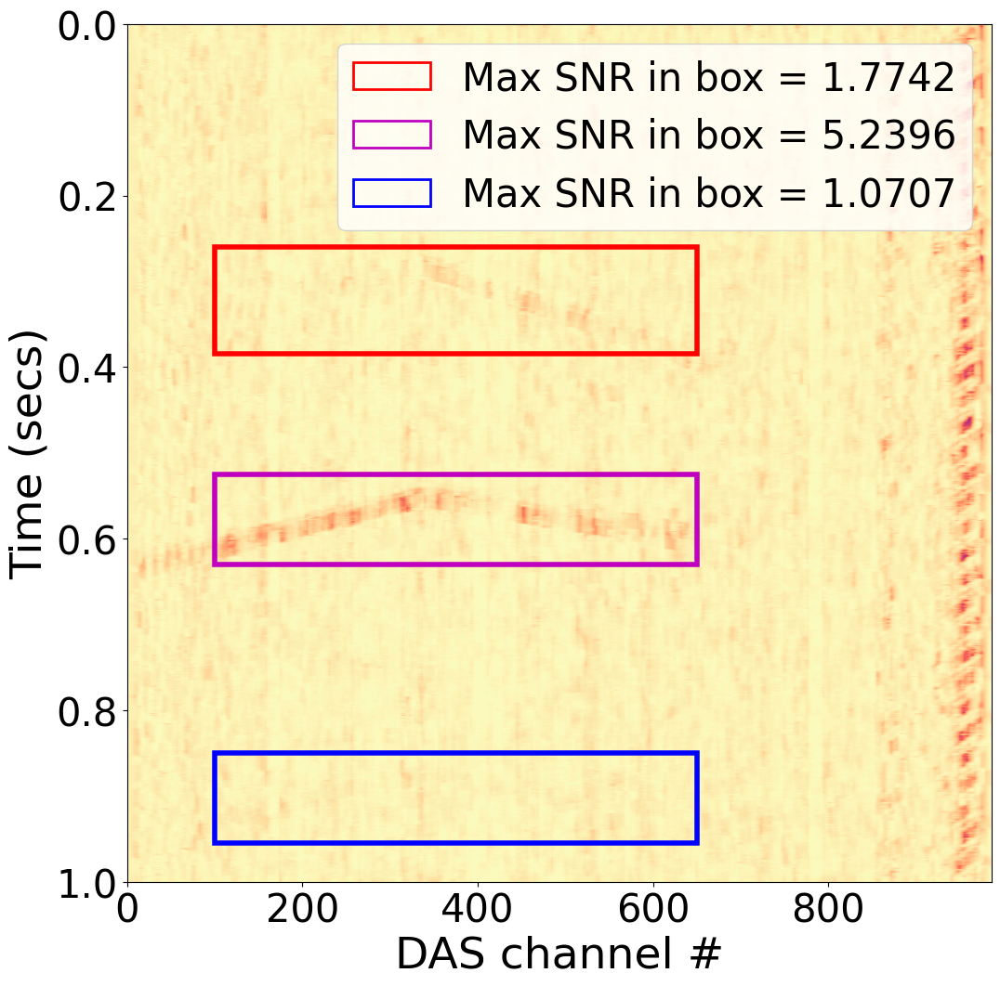

In [66]:
# Plot local SNR for jDAS data

# Create figure and axes
S = S_jdas_ex
fig, ax = plt.subplots()
# Plot SNR
im = ax.imshow(S / (1. - S), vmin = 0, vmax = 15, cmap="magma_r", aspect="auto", extent=[0,S.shape[-1],S.shape[0]/1000,0]) # SNR = S / 1 - S (Eq 7, https://doi.org/10.1111/1365-2478.13178)
# Draw box over top of event and find max SNR in box
# Create a Rectangle patch
rect1 = patches.Rectangle((100, 0.260), 550, 0.125, linewidth=4, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((100, 0.525), 550, 0.105, linewidth=4, edgecolor='m', facecolor='none')
rect3 = patches.Rectangle((100, 0.850), 550, 0.105, linewidth=4, edgecolor='b', facecolor='none')
# Add the patch to plot
ax.add_patch(rect1)
ax.add_patch(rect2)
ax.add_patch(rect3)
ax.legend(handles=[Patch(facecolor='none', edgecolor='r', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[270:395, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[260:385, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='m', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[435:640, 100:650]) - np.mean((S / (1. - S))[:100, :]))),
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[425:630, 100:650], q=95) - np.mean((S / (1. - S))[:100, :]))),
                   Patch(facecolor='none', edgecolor='b', linewidth=2,
                         label='Max SNR in box = ' + '{:.4f}'.format(np.amax((S / (1. - S))[860:965, 100:650]) - np.mean((S / (1. - S))[:100, :])))
                         # label='Max SNR in box = ' + '{:.4f}'.format(np.percentile((S / (1. - S))[850:955, 100:650], q=95) - np.mean((S / (1. - S))[:100, :])))
                  ], prop={'size': 30})
# Labels and ticks
plt.xlabel('DAS channel #', fontsize=34)
plt.ylabel('Time (secs)', fontsize=34)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.show()